In [75]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import LinearSegmentedColormap
import numpy as np

In [76]:
########## SQ strategy

In [77]:
#SQ = pd.read_csv(r'../../results/computed-fuel-rates-oct2021-sep2022.csv', low_memory=False)
SQ = pd.read_csv(r'../../results/computed-fuel-rates-oct2021-sep2022-12212023.csv', low_memory=False)

In [78]:
#SQ.columns

In [122]:
SQ_copy=SQ.copy()
SQ_copy['diesel'] = SQ_copy['Energy'].apply(lambda x: x if x != 'electric' else 0)
#SQ_copy['CO2'] = SQ_copy['diesel']*0.01086879 ### For each gallon of diesel burned, 9.86 kgCO$_2$e of greenhouse gas (GHG) emissions are produced.
#9.86kg = 0.01086879 us tons

SQ_copy['CO2'] = SQ_copy['diesel'] * 0.01130475  ### For each gallon of diesel burned, 10.25 kgCO2e of greenhouse gas (GHG) emissions are produced.
# 10.25kg = 0.01130475 US tons



# Group by 'Route' and sum
grouped = SQ_copy.groupby('Route').agg({'CO2': 'sum', 'diesel': 'sum', 'dist': 'sum'}).reset_index()
# Calculate per mile columns
grouped['CO2_per_mile'] = grouped['CO2'] / grouped['dist']
grouped['diesel_per_mile'] = grouped['diesel'] / grouped['dist']
grouped

,Route,CO2,diesel,dist,CO2_per_mile,diesel_per_mile
0,(X) 34,15.143865,1339.601894,3493.935877,0.004334,0.383408
1,(X) 38,50.254482,4445.430601,12031.694755,0.004177,0.369477
2,(X) 39E,12.158662,1075.535711,4020.914645,0.003024,0.267485
3,(X) 801,2.546717,225.278457,457.136333,0.005571,0.492804
4,(X) 802,3.240215,286.624164,672.684756,0.004817,0.426090
...,...,...,...,...,...,...
65,R41,210.577397,18627.337828,58438.453463,0.003603,0.318751
66,R42,181.869191,16087.856088,65889.851650,0.002760,0.244163
67,R44,212.875703,18830.642208,50927.972035,0.004180,0.369750
68,X90,599.350338,53017.566785,143406.064045,0.004179,0.369702


In [123]:
# Replace leading '(X)' and any leading whitespace
grouped['Route'] = grouped['Route'].str.replace(r'^\(X\)\s*', '', regex=True)
grouped['Route'].unique()

array(['34', '38', '39E', '801', '802', '803', '804', '805', '806', '820',
       '821', '823', '824', '892', '902', '943', 'B9', 'P11', '30', '31',
       '33', '35', '36', '45', '46', '890', '921', '9999', 'B12', 'B17',
       'B23', 'B4', 'B43', 'B48', 'B6', 'B7', 'B79', 'G1', 'G2', 'G3',
       'G5', 'G73', 'P20', 'P21', 'R10', 'R14', 'R24', 'R29', 'R41',
       'R42', 'R44', 'X90', 'X92'], dtype=object)

In [124]:
#grouped.to_csv(r'../../results/Status quo-diesel-whole-year.csv', index=False)

In [125]:
#grouped_trips

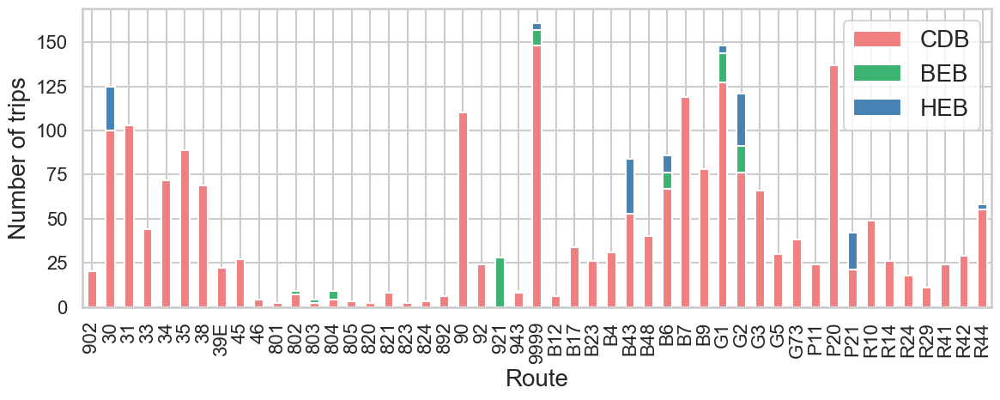

In [126]:
# Filter the dataframe for date 2021-10-29
SQ_filtered = SQ.loc[SQ['Date']=='2021-10-29'].copy()

# Remove X and (X) from routes names
SQ_filtered['Route'] = SQ_filtered['Route'].str.replace(r'\(X\)', '', regex=True) # replace (X)
SQ_filtered['Route'] = SQ_filtered['Route'].str.replace('X', '', regex=False) # replace X

# Group by Route and Powertrain to count unique trips
grouped_trips = SQ_filtered.groupby(['Route', 'Powertrain'])['Trip'].nunique().unstack(fill_value=0)

# Rename columns
grouped_trips = grouped_trips.rename(columns={
    'conventional': 'CDB',
    'hybrid': 'HEB',
    'electric': 'BEB'
})


# Plot
# Create a figure and a set of subplots with larger size
fig, ax = plt.subplots(figsize=(12, 5))

colors = {'CDB': 'lightcoral', 'HEB': 'steelblue', 'BEB': 'mediumseagreen'}
ax = grouped_trips.plot(kind='bar', stacked=True, color=[colors[col] for col in grouped_trips.columns], ax=ax)

# Annotate with BEB percentages
for index, (route, row) in enumerate(grouped_trips.iterrows()):
    total = row.sum()
    BEB_count = row.get('BEB', 0)
    percentage = (BEB_count / total) * 100
    
# Set the title and labels with larger font sizes
ax.set_xlabel('Route', fontsize=20)
ax.set_ylabel('Number of trips', fontsize=20)
ax.legend(fontsize=20)
#ax.set_xlabel('')
#ax.set_xticks([])
# Increase the font size for tick labels
ax.tick_params(axis='both', labelsize=16)

plt.tight_layout()

fig.savefig(r'../../figures/SQ_route_electrification.png', dpi=400)  

plt.show()


In [127]:
# Compute the total BEB counts and total trips
total_BEB_counts = grouped_trips['BEB'].sum()
total_trips = grouped_trips.sum(axis=1).sum()

# Calculate average %BEB across all routes
average_percentage_BEB = (total_BEB_counts / total_trips) * 100

print(f"Average %BEB across all routes: {average_percentage_BEB:.2f}%")


Average %BEB across all routes: 3.82%


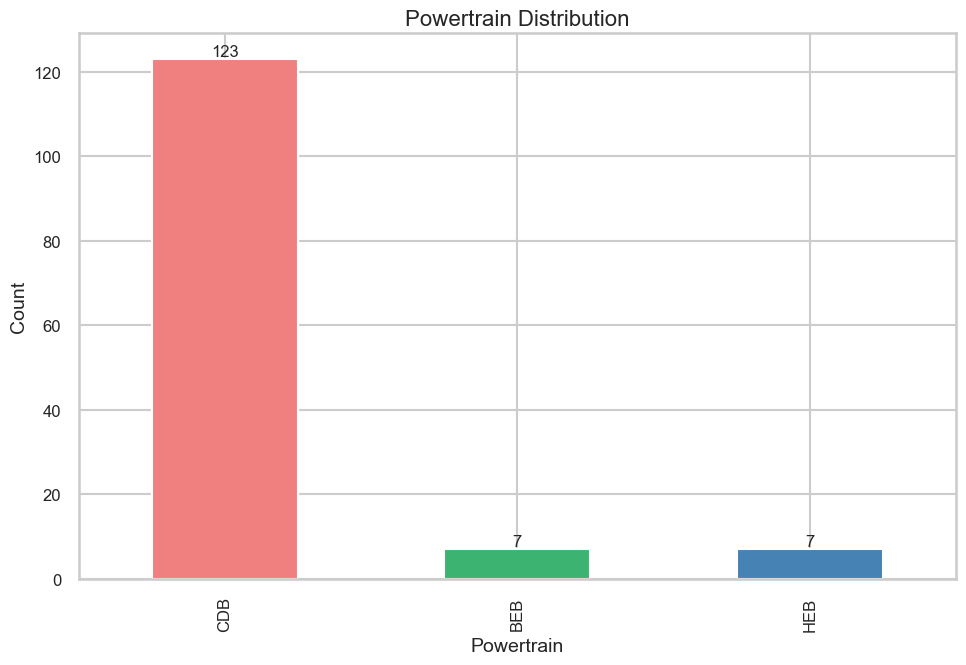

In [128]:
# Drop duplicate Vehicles while retaining the associated Powertrain
unique_vehicles = SQ_filtered.drop_duplicates(subset='Vehicle', keep='first')

# Count occurrences of each Powertrain
powertrain_counts = unique_vehicles['Powertrain'].value_counts()

# Define colors
colors = {'conventional': 'lightcoral', 'hybrid': 'steelblue', 'electric': 'mediumseagreen'}

# Create a larger plot with increased font size
plt.figure(figsize=(10,7))
ax = powertrain_counts.plot(kind='bar', color=[colors[p] for p in powertrain_counts.index])

# Annotate bars with their count
for i, v in enumerate(powertrain_counts):
    ax.text(i, v + 0.1, str(v), ha='center', va='bottom', fontsize=12)

# Labels, title, and formatting
plt.xlabel('Powertrain', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.title('Powertrain Distribution', fontsize=16)
labels = {'conventional': 'CDB', 'hybrid': 'HEB', 'electric': 'BEB'}
plt.xticks(range(len(powertrain_counts.index)), [labels[p] for p in powertrain_counts.index], fontsize=12)
plt.yticks(fontsize=12)
plt.tight_layout()

plt.show()

In [129]:
# Calculate sum for each Year for each DataFrame
#h_FH_variables['Result'] = h_FH_variables['Value'] * h_FH_variables['Coefficient']
#h_FH_sum = h_FH_variables.groupby('Year')['Result'].sum().reset_index()

#m_FH_variables['Result'] = m_FH_variables['Value'] * m_FH_variables['Coefficient']
#m_FH_sum = m_FH_variables.groupby('Year')['Result'].sum().reset_index()

#l_FH_variables['Result'] = l_FH_variables['Value'] * l_FH_variables['Coefficient']
#l_FH_sum = l_FH_variables.groupby('Year')['Result'].sum().reset_index()

# Add Scenario and Strategy columns
#h_FH_sum['Scenario'] = 'h'
#h_FH_sum['Strategy'] = 'FH'

#m_FH_sum['Scenario'] = 'm'
#m_FH_sum['Strategy'] = 'FH'

#l_FH_sum['Scenario'] = 'l'
#l_FH_sum['Strategy'] = 'FH'

# Concatenate the DataFrames
#final_df = pd.concat([h_FH_sum, m_FH_sum, l_FH_sum])

# Rearrange the columns
#final_df = final_df[['Year', 'Result', 'Scenario', 'Strategy']]
#final_df.to_csv(r'../../results/diesel-FH.csv', index=False)

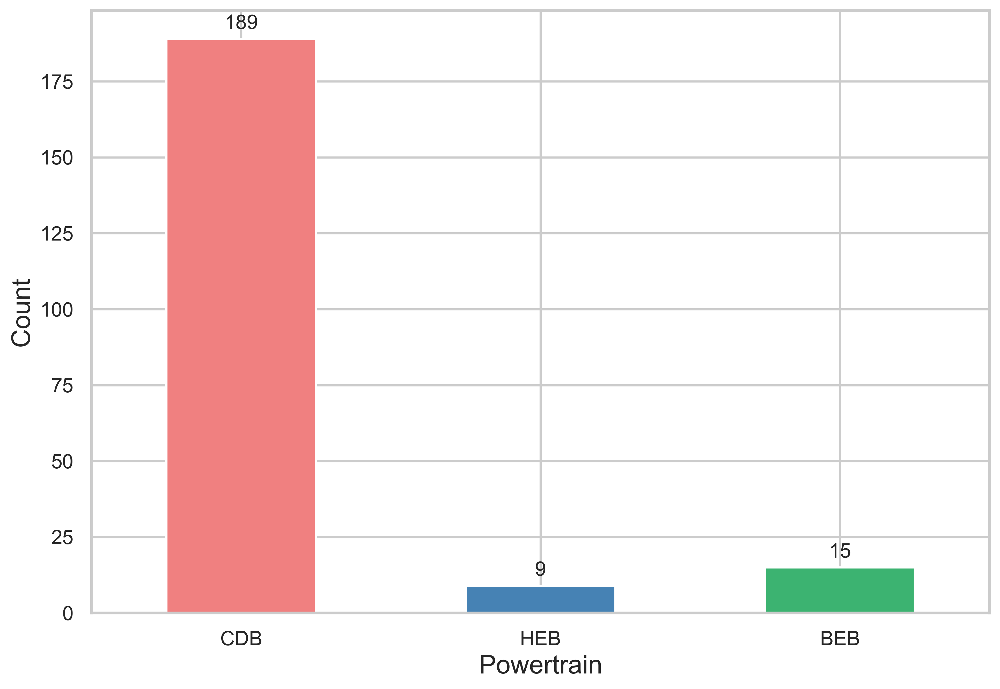

In [130]:
# Define counts and their labels
powertrain_counts = pd.Series({'conventional': 189, 'hybrid': 9, 'electric': 15})

# Define colors
colors = {'conventional': 'lightcoral', 'hybrid': 'steelblue', 'electric': 'mediumseagreen'}

# Create a larger plot with increased font size
plt.figure(figsize=(10,7), dpi=400)
ax = powertrain_counts.plot(kind='bar', color=[colors[p] for p in powertrain_counts.index])

# Annotate bars with their count
for i, v in enumerate(powertrain_counts):
    ax.text(i, v + 2, str(v), ha='center', va='bottom', fontsize=14)  # increased y-value a bit for better placement

# Labels, title, and formatting
plt.xlabel('Powertrain', fontsize=18)
plt.ylabel('Count', fontsize=18)
#plt.title('Powertrain Distribution', fontsize=22)
labels = {'conventional': 'CDB', 'hybrid': 'HEB', 'electric': 'BEB'}
plt.xticks(range(len(powertrain_counts.index)), [labels[p] for p in powertrain_counts.index], fontsize=14, rotation=0)  # set rotation to 0
plt.yticks(fontsize=14)
plt.tight_layout()
plt.savefig(r'../../figures/fleet.png', dpi=400)  

plt.show()

In [131]:
# Create the 'Result' column in SQ dataframe
SQ['Result'] = SQ['Energy']
SQ.loc[SQ['Powertrain'] == 'electric', 'Result'] = 0
SQ_busiest = SQ.loc[SQ['Date']=='2021-10-29'].copy()


# Create the final_df dataframe
# Start by summing the Result values
total_result = SQ_busiest['Result'].sum()
# Create the dataframe with 'Year' values ranging from 0 to 12
df_SQ = pd.DataFrame({'Year': range(13)})

# Fill the other columns
df_SQ['Result'] = total_result
df_SQ['Scenario'] = 'c'
df_SQ['Strategy'] = 'SQ'

In [132]:
total_result

4177.557119555364

In [133]:
SQ_busiest['Result'].sum()

4177.557119555364

In [134]:
# Group by Route and Powertrain to count unique trips
trips = SQ_filtered.groupby(['Powertrain'])['dist'].sum()

In [135]:
trips

Powertrain
conventional    11385.853110
electric          382.411114
hybrid            772.229864
Name: dist, dtype: float64

In [136]:
11386.146799/(11386.146799+382.512323+772.229864)

0.9079218237009278

In [137]:
382.512323/(11386.146799+382.512323+772.229864)

0.030501212747119994

In [138]:
772.229864/(11386.146799+382.512323+772.229864)

0.06157696355195213

In [139]:
11386.146799+382.512323+772.229864

12540.888986000002

In [140]:
df_SQ_diesel=pd.read_csv(r'../../results/diesel-SQ-calibrated.csv', low_memory=False)

In [141]:
df_SQ_diesel

,Year,Result,Scenario,Strategy,dist_BEB,dist_CDB,dist_HEB
0,0,2738.75,c,SQ,674.998976,10965,899.999
1,1,2738.75,c,SQ,674.998976,10965,899.999
2,2,2738.75,c,SQ,674.998976,10965,899.999
3,3,2738.75,c,SQ,674.998976,10965,899.999
4,4,2738.75,c,SQ,674.998976,10965,899.999
5,5,2738.75,c,SQ,674.998976,10965,899.999
6,6,2738.75,c,SQ,674.998976,10965,899.999
7,7,2738.75,c,SQ,674.998976,10965,899.999
8,8,2738.75,c,SQ,674.998976,10965,899.999
9,9,2738.75,c,SQ,674.998976,10965,899.999


In [142]:
max_year = 18
current_max_year = df_SQ_diesel['Year'].max()

# Number of rows to add
rows_to_add = max_year - current_max_year

# Repeat the last row as needed, update the Year accordingly
new_rows = pd.DataFrame([df_SQ_diesel.iloc[-1]] * rows_to_add)
new_rows = new_rows.reset_index(drop=True)
new_rows['Year'] = range(current_max_year + 1, max_year + 1)

# Append to the original DataFrame
df_SQ_diesel_extended = pd.concat([df_SQ_diesel, new_rows], ignore_index=True)

# If you want to reset the index just to keep it clean:
df_SQ_diesel_extended.reset_index(drop=True, inplace=True)

df_SQ_diesel = df_SQ_diesel_extended.copy()
df_SQ_diesel

,Year,Result,Scenario,Strategy,dist_BEB,dist_CDB,dist_HEB
0,0,2738.75,c,SQ,674.998976,10965,899.999
1,1,2738.75,c,SQ,674.998976,10965,899.999
2,2,2738.75,c,SQ,674.998976,10965,899.999
3,3,2738.75,c,SQ,674.998976,10965,899.999
4,4,2738.75,c,SQ,674.998976,10965,899.999
5,5,2738.75,c,SQ,674.998976,10965,899.999
6,6,2738.75,c,SQ,674.998976,10965,899.999
7,7,2738.75,c,SQ,674.998976,10965,899.999
8,8,2738.75,c,SQ,674.998976,10965,899.999
9,9,2738.75,c,SQ,674.998976,10965,899.999


In [143]:
df_BM = pd.read_csv(r'../../results/diesel-BM-with-replacement-40percentBEBcharging-ContiniuedTo2040.csv', low_memory=False)

In [144]:
# Step 1: Increment all years in df_BM by 1
df_BM['Year'] += 1

# Step 2: Get the reference row from df_SQ_diesel for Year == 0
reference_row = df_SQ_diesel[df_SQ_diesel['Year'] == 0].iloc[0]
reference_data = {
    'Result': reference_row['Result'],
    'dist_BEB': reference_row['dist_BEB'],
    'dist_CDB': reference_row['dist_CDB'],
    'dist_HEB': reference_row['dist_HEB']
}

# Step 3: Create Year=0 rows for each (Scenario, Strategy) in df_BM
new_rows = []
for (scenario, strategy) in df_BM[['Scenario', 'Strategy']].drop_duplicates().values:
    row = {
        'Year': 0,
        'Scenario': scenario,
        'Strategy': strategy,
        **reference_data
    }
    new_rows.append(row)

df_new = pd.DataFrame(new_rows)

# Step 4: Combine and sort
df_combined = pd.concat([df_new, df_BM], ignore_index=True)
df_combined = df_combined.sort_values(by=['Scenario', 'Strategy', 'Year']).reset_index(drop=True)


df_BM = df_combined.copy()
df_BM

,Year,Scenario,Strategy,Result,dist_BEB,dist_CDB,dist_HEB
0,0,h,BM,2738.750000,674.998976,10965.000000,899.999000
1,1,h,BM,2509.166434,899.962158,8141.063040,3499.863788
2,2,h,BM,2267.903556,1034.975071,5106.008601,6399.905314
3,3,h,BM,2058.855641,1214.955419,2226.062975,9099.870592
4,4,h,BM,1851.011841,1709.971760,31.068123,10799.849103
5,5,h,BM,1806.364865,1889.989571,0.000000,10650.899415
6,6,h,BM,1703.192429,2339.993506,0.000000,10200.895480
7,7,h,BM,1497.280964,3284.981784,0.000000,9255.907202
8,8,h,BM,1283.674472,4319.998170,0.000000,8220.890815
9,9,h,BM,1079.595665,5354.999465,0.000000,7185.889521


In [145]:
df_FE = pd.read_csv(r'../../results/diesel-FE-with-replacement-40percentBEBcharging-ContiniuedTo2040.csv', low_memory=False)

In [146]:
# Step 1: Increment all years in df_BM by 1
df_FE['Year'] += 1

# Step 2: Get the reference row from df_SQ_diesel for Year == 0
reference_row = df_SQ_diesel[df_SQ_diesel['Year'] == 0].iloc[0]
reference_data = {
    'Result': reference_row['Result'],
    'dist_BEB': reference_row['dist_BEB'],
    'dist_CDB': reference_row['dist_CDB'],
    'dist_HEB': reference_row['dist_HEB']
}

# Step 3: Create Year=0 rows for each (Scenario, Strategy) in df_BM
new_rows = []
for (scenario, strategy) in df_FE[['Scenario', 'Strategy']].drop_duplicates().values:
    row = {
        'Year': 0,
        'Scenario': scenario,
        'Strategy': strategy,
        **reference_data
    }
    new_rows.append(row)

df_new = pd.DataFrame(new_rows)

# Step 4: Combine and sort
df_combined = pd.concat([df_new, df_FE], ignore_index=True)
df_combined = df_combined.sort_values(by=['Scenario', 'Strategy', 'Year']).reset_index(drop=True)


df_FE = df_combined.copy()
df_FE

,Year,Scenario,Strategy,Result,dist_BEB,dist_CDB,dist_HEB
0,0,h,FE,2738.750000,674.998976,10965.000000,899.999000
1,1,h,FE,2672.537532,1034.982871,10606.015539,899.890576
2,2,h,FE,2672.596787,1034.981133,10606.004049,899.903804
3,3,h,FE,2609.334038,1214.951496,10426.047249,899.890241
4,4,h,FE,2443.196301,1709.966467,9930.954668,899.967851
5,5,h,FE,2385.686376,1889.994592,9751.048648,899.845746
6,6,h,FE,2246.519904,2339.972982,9300.932767,899.983237
7,7,h,FE,1968.173015,3284.936739,8356.026502,899.925744
8,8,h,FE,1680.461686,4319.971538,7320.926558,899.990889
9,9,h,FE,1406.054495,5354.983595,6285.999616,899.905774


In [147]:
df_FH = pd.read_csv(r'../../results/diesel-FH-with-replacement-ContiniuedTo2040.csv', low_memory=False)
df_FH

,Year,Result,Scenario,Strategy,dist_BEB,dist_CDB,dist_HEB
0,0,2535.812907,h,FH,674.996965,7666.020443,4199.871578
1,1,2319.375537,h,FH,674.999653,4365.924070,7499.965263
2,2,2151.339705,h,FH,674.996965,1066.046823,10799.845198
3,3,2116.845970,h,FH,674.972509,0.000000,11865.916477
4,4,2116.845970,h,FH,674.972509,0.000000,11865.916477
5,5,2116.845970,h,FH,674.972509,0.000000,11865.916477
6,6,2116.845970,h,FH,674.972509,0.000000,11865.916477
7,7,2116.845970,h,FH,674.972509,0.000000,11865.916477
8,8,2116.845970,h,FH,674.972509,0.000000,11865.916477
9,9,2116.845970,h,FH,674.972509,0.000000,11865.916477


In [148]:
# Step 1: Increment all years in df_BM by 1
df_FH['Year'] += 1

# Step 2: Get the reference row from df_SQ_diesel for Year == 0
reference_row = df_SQ_diesel[df_SQ_diesel['Year'] == 0].iloc[0]
reference_data = {
    'Result': reference_row['Result'],
    'dist_BEB': reference_row['dist_BEB'],
    'dist_CDB': reference_row['dist_CDB'],
    'dist_HEB': reference_row['dist_HEB']
}

# Step 3: Create Year=0 rows for each (Scenario, Strategy) in df_BM
new_rows = []
for (scenario, strategy) in df_FH[['Scenario', 'Strategy']].drop_duplicates().values:
    row = {
        'Year': 0,
        'Scenario': scenario,
        'Strategy': strategy,
        **reference_data
    }
    new_rows.append(row)

df_new = pd.DataFrame(new_rows)

# Step 4: Combine and sort
df_combined = pd.concat([df_new, df_FH], ignore_index=True)
df_combined = df_combined.sort_values(by=['Scenario', 'Strategy', 'Year']).reset_index(drop=True)


df_FH = df_combined.copy()
df_FH

,Year,Scenario,Strategy,Result,dist_BEB,dist_CDB,dist_HEB
0,0,h,FH,2738.750000,674.998976,10965.000000,899.999000
1,1,h,FH,2535.812907,674.996965,7666.020443,4199.871578
2,2,h,FH,2319.375537,674.999653,4365.924070,7499.965263
3,3,h,FH,2151.339705,674.996965,1066.046823,10799.845198
4,4,h,FH,2116.845970,674.972509,0.000000,11865.916477
5,5,h,FH,2116.845970,674.972509,0.000000,11865.916477
6,6,h,FH,2116.845970,674.972509,0.000000,11865.916477
7,7,h,FH,2116.845970,674.972509,0.000000,11865.916477
8,8,h,FH,2116.845970,674.972509,0.000000,11865.916477
9,9,h,FH,2116.845970,674.972509,0.000000,11865.916477


In [149]:
#df_PP = pd.read_csv(r'../../results/diesel-PP-with-replacement.csv', low_memory=False)

In [184]:
# List of dataframes to concatenate
dfs = [df_SQ_diesel, df_FH, df_FE, df_BM]

# Concatenate the dataframes
final_df = pd.concat(dfs, ignore_index=True)
final_df

,Year,Result,Scenario,Strategy,dist_BEB,dist_CDB,dist_HEB
0,0,2738.750000,c,SQ,674.998976,10965.0,899.999000
1,1,2738.750000,c,SQ,674.998976,10965.0,899.999000
2,2,2738.750000,c,SQ,674.998976,10965.0,899.999000
3,3,2738.750000,c,SQ,674.998976,10965.0,899.999000
4,4,2738.750000,c,SQ,674.998976,10965.0,899.999000
...,...,...,...,...,...,...,...
185,14,645.890019,m,BM,7739.991687,0.0,4800.897299
186,15,533.541676,m,BM,8414.971644,0.0,4125.917342
187,16,425.615739,m,BM,9089.875157,0.0,3451.013828
188,17,323.111088,m,BM,9764.998531,0.0,2775.890455


In [185]:
final_df.loc[final_df['Year']==0]

,Year,Result,Scenario,Strategy,dist_BEB,dist_CDB,dist_HEB
0,0,2738.75,c,SQ,674.998976,10965.0,899.999
19,0,2738.75,h,FH,674.998976,10965.0,899.999
38,0,2738.75,l,FH,674.998976,10965.0,899.999
57,0,2738.75,m,FH,674.998976,10965.0,899.999
76,0,2738.75,h,FE,674.998976,10965.0,899.999
95,0,2738.75,l,FE,674.998976,10965.0,899.999
114,0,2738.75,m,FE,674.998976,10965.0,899.999
133,0,2738.75,h,BM,674.998976,10965.0,899.999
152,0,2738.75,l,BM,674.998976,10965.0,899.999
171,0,2738.75,m,BM,674.998976,10965.0,899.999


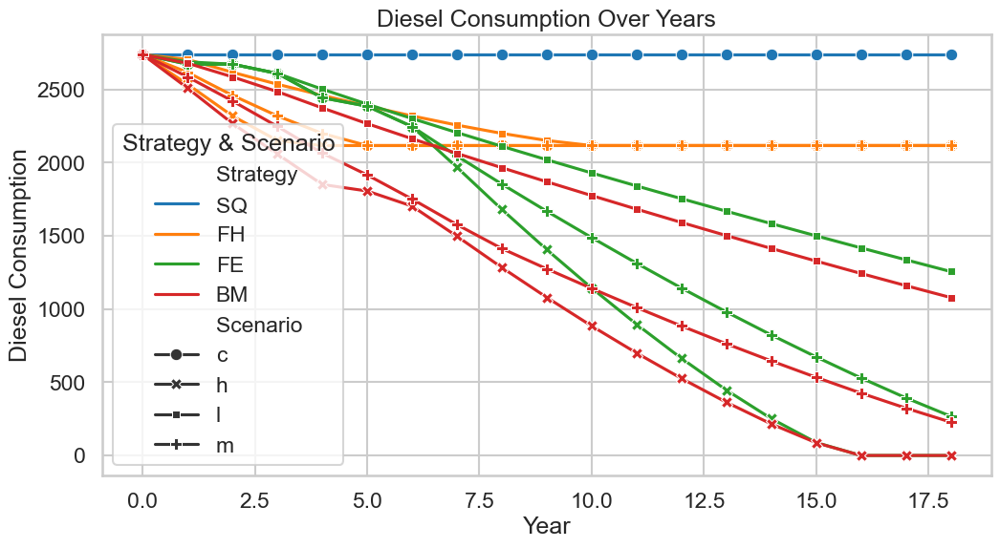

In [186]:
# Ensure that the data types are appropriate for plotting
final_df['Year'] = final_df['Year'].astype(int)
final_df['Result'] = final_df['Result'].astype(float)

# Create the line plot using seaborn
plt.figure(figsize=(12, 6))
sns.lineplot(data=final_df, x='Year', y='Result', hue='Strategy', style='Scenario', markers=True, dashes=False)

# Add titles and labels
plt.title('Diesel Consumption Over Years')
plt.xlabel('Year')
plt.ylabel('Diesel Consumption')
plt.legend(title='Strategy & Scenario')

# Display the plot
plt.show()


In [187]:
# Define the mapping
year_mapping = {i: 2022 + i for i in range(0, 19)}

# Apply mapping only where the key exists, others become NaN
final_df['Year'] = final_df['Year'].map(year_mapping)

# Drop or fill invalid (NaN) mappings before converting to int
final_df = final_df[final_df['Year'].notna()]  # drops rows where mapping failed
final_df['Year'] = final_df['Year'].astype(int)

print(final_df)

     Year       Result Scenario Strategy      dist_BEB  dist_CDB     dist_HEB
0    2022  2738.750000        c       SQ    674.998976   10965.0   899.999000
1    2023  2738.750000        c       SQ    674.998976   10965.0   899.999000
2    2024  2738.750000        c       SQ    674.998976   10965.0   899.999000
3    2025  2738.750000        c       SQ    674.998976   10965.0   899.999000
4    2026  2738.750000        c       SQ    674.998976   10965.0   899.999000
..    ...          ...      ...      ...           ...       ...          ...
185  2036   645.890019        m       BM   7739.991687       0.0  4800.897299
186  2037   533.541676        m       BM   8414.971644       0.0  4125.917342
187  2038   425.615739        m       BM   9089.875157       0.0  3451.013828
188  2039   323.111088        m       BM   9764.998531       0.0  2775.890455
189  2040   227.294178        m       BM  10439.936587       0.0  2100.952398

[190 rows x 7 columns]


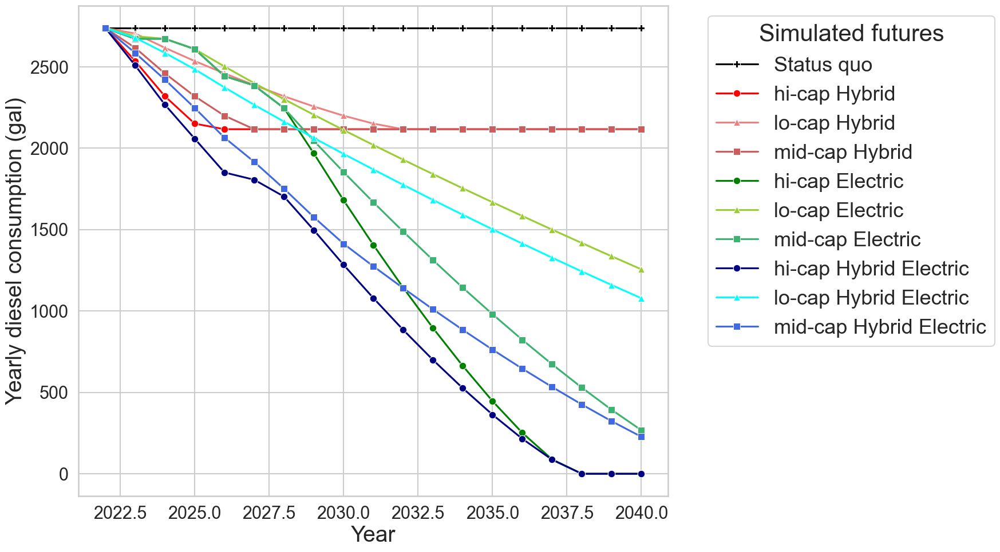

In [191]:
# Mapping combinations to desired names
mapping = {
    ('c', 'SQ'): 'Status quo',
    ('l', 'FH'): 'lo-cap Hybrid',
    ('m', 'FH'): 'mid-cap Hybrid',
    ('h', 'FH'): 'hi-cap Hybrid',
    ('l', 'FE'): 'lo-cap Electric',
    ('m', 'FE'): 'mid-cap Electric',
    ('h', 'FE'): 'hi-cap Electric',
    ('l', 'BM'): 'lo-cap Hybrid Electric',
    ('m', 'BM'): 'mid-cap Hybrid Electric',
    ('h', 'BM'): 'hi-cap Hybrid Electric'
}



final_df['Label'] = final_df.set_index(['Scenario', 'Strategy']).index.map(mapping.get).values
unique_labels = final_df['Label'].unique()

# Improve the plot
sns.set_style("whitegrid")
sns.set_context("talk")  # makes everything larger

# Create a color palette
#palette = sns.color_palette('tab10', n_colors=len(unique_labels))

# Define a custom palette and marker order
custom_palette = {
    "Status quo": "black",
    "lo-cap Hybrid": "lightcoral",
    "mid-cap Hybrid": "indianred",
    "hi-cap Hybrid": "red",
    "lo-cap Hybrid Electric": "aqua",
    "mid-cap Hybrid Electric": "royalblue",
    "hi-cap Hybrid Electric": "navy",
    "lo-cap Electric": "yellowgreen",
    "mid-cap Electric": "mediumseagreen",
    "hi-cap Electric": "green"
}
custom_markers = {
    "Status quo": "P",
    "lo-cap Hybrid": "^",
    "mid-cap Hybrid": "s",
    "hi-cap Hybrid": "o",
    "lo-cap Hybrid Electric": "^",
    "mid-cap Hybrid Electric": "s",
    "hi-cap Hybrid Electric": "o",
    "lo-cap Electric": "^",
    "mid-cap Electric": "s",
    "hi-cap Electric": "o"
}

plt.figure(figsize=(18, 10))

# Use a loop to plot each category with its unique marker and color
for label in unique_labels:
    subset = final_df[final_df['Label'] == label]
    sns.lineplot(data=subset, x='Year', y='Result', label=label, dashes=False, 
                 color=custom_palette[label], marker=custom_markers[label])

# Add titles and labels
#plt.title('Diesel Consumption Over Years', fontsize=20)
plt.xlabel('Year', fontsize=28)
plt.ylabel('Yearly diesel consumption (gal)', fontsize=28)
plt.legend(title='Simulated futures', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=26, title_fontsize=30)
#plt.legend(handles=plot.get_lines(), labels=unique_labels, title='Configurations', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(fontsize=22)

plt.yticks(fontsize=22)

# Save the plot
plt.tight_layout()
plt.savefig(r'../../figures/diesel-consumption.png', dpi=400)

# Display the plot
plt.show()


In [192]:
final_df

,Year,Result,Scenario,Strategy,dist_BEB,dist_CDB,dist_HEB,Label
0,2022,2738.750000,c,SQ,674.998976,10965.0,899.999000,Status quo
1,2023,2738.750000,c,SQ,674.998976,10965.0,899.999000,Status quo
2,2024,2738.750000,c,SQ,674.998976,10965.0,899.999000,Status quo
3,2025,2738.750000,c,SQ,674.998976,10965.0,899.999000,Status quo
4,2026,2738.750000,c,SQ,674.998976,10965.0,899.999000,Status quo
...,...,...,...,...,...,...,...,...
185,2036,645.890019,m,BM,7739.991687,0.0,4800.897299,mid-cap Hybrid Electric
186,2037,533.541676,m,BM,8414.971644,0.0,4125.917342,mid-cap Hybrid Electric
187,2038,425.615739,m,BM,9089.875157,0.0,3451.013828,mid-cap Hybrid Electric
188,2039,323.111088,m,BM,9764.998531,0.0,2775.890455,mid-cap Hybrid Electric


In [193]:
ratios = pd.read_csv(r'../../results/diesel-consumption-distribution-compared-to-busiest-day.csv', low_memory=False)

In [194]:
ratios.columns

Index(['Date', 'UniqueTripsCount', 'Diesel', 'DieselRatio'], dtype='object')

In [195]:
### Scale up the busiest day to a whole year
final_df['YearlyResult'] = final_df['Result'].apply(lambda x: sum(x * ratios['DieselRatio']))
final_df['Yearly_dist_CDB'] = final_df['dist_CDB'].apply(lambda x: sum(x * ratios['DieselRatio']))
final_df['Yearly_dist_HEB'] = final_df['dist_HEB'].apply(lambda x: sum(x * ratios['DieselRatio']))
final_df['Yearly_dist_BEB'] = final_df['dist_BEB'].apply(lambda x: sum(x * ratios['DieselRatio']))



final_df

,Year,Result,Scenario,Strategy,dist_BEB,dist_CDB,dist_HEB,Label,YearlyResult,Yearly_dist_CDB,Yearly_dist_HEB,Yearly_dist_BEB
0,2022,2738.750000,c,SQ,674.998976,10965.0,899.999000,Status quo,707460.738888,2.832426e+06,2.324834e+05,1.743625e+05
1,2023,2738.750000,c,SQ,674.998976,10965.0,899.999000,Status quo,707460.738888,2.832426e+06,2.324834e+05,1.743625e+05
2,2024,2738.750000,c,SQ,674.998976,10965.0,899.999000,Status quo,707460.738888,2.832426e+06,2.324834e+05,1.743625e+05
3,2025,2738.750000,c,SQ,674.998976,10965.0,899.999000,Status quo,707460.738888,2.832426e+06,2.324834e+05,1.743625e+05
4,2026,2738.750000,c,SQ,674.998976,10965.0,899.999000,Status quo,707460.738888,2.832426e+06,2.324834e+05,1.743625e+05
...,...,...,...,...,...,...,...,...,...,...,...,...
185,2036,645.890019,m,BM,7739.991687,0.0,4800.897299,mid-cap Hybrid Electric,166843.205944,0.000000e+00,1.240145e+06,1.999357e+06
186,2037,533.541676,m,BM,8414.971644,0.0,4125.917342,mid-cap Hybrid Electric,137821.921839,0.000000e+00,1.065787e+06,2.173715e+06
187,2038,425.615739,m,BM,9089.875157,0.0,3451.013828,mid-cap Hybrid Electric,109943.012423,0.000000e+00,8.914493e+05,2.348053e+06
188,2039,323.111088,m,BM,9764.998531,0.0,2775.890455,mid-cap Hybrid Electric,83464.503435,0.000000e+00,7.170547e+05,2.522447e+06


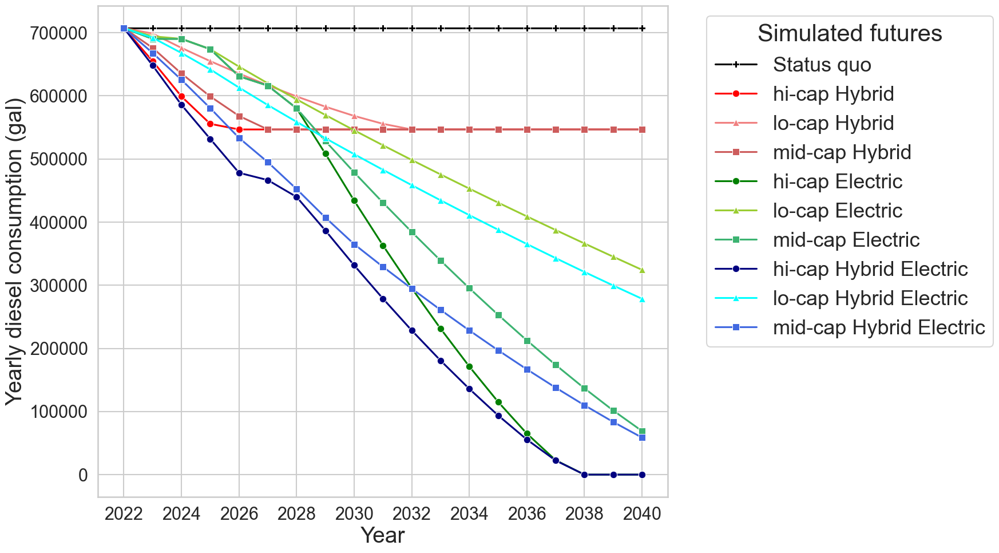

In [198]:
import matplotlib.ticker as ticker


# Mapping combinations to desired names
mapping = {
    ('c', 'SQ'): 'Status quo',
    ('l', 'FH'): 'lo-cap Hybrid',
    ('m', 'FH'): 'mid-cap Hybrid',
    ('h', 'FH'): 'hi-cap Hybrid',
    ('l', 'FE'): 'lo-cap Electric',
    ('m', 'FE'): 'mid-cap Electric',
    ('h', 'FE'): 'hi-cap Electric',
    ('l', 'BM'): 'lo-cap Hybrid Electric',
    ('m', 'BM'): 'mid-cap Hybrid Electric',
    ('h', 'BM'): 'hi-cap Hybrid Electric'
}



#final_df['Year'] = final_df['Year'] + 22

final_df['Label'] = final_df.set_index(['Scenario', 'Strategy']).index.map(mapping.get).values
unique_labels = final_df['Label'].unique()

# Improve the plot
sns.set_style("whitegrid")
sns.set_context("talk")  # makes everything larger

# Create a color palette
#palette = sns.color_palette('tab10', n_colors=len(unique_labels))

# Define a custom palette and marker order
custom_palette = {
    "Status quo": "black",
    "lo-cap Hybrid": "lightcoral",
    "mid-cap Hybrid": "indianred",
    "hi-cap Hybrid": "red",
    "lo-cap Hybrid Electric": "aqua",
    "mid-cap Hybrid Electric": "royalblue",
    "hi-cap Hybrid Electric": "navy",
    "lo-cap Electric": "yellowgreen",
    "mid-cap Electric": "mediumseagreen",
    "hi-cap Electric": "green"
}
custom_markers = {
    "Status quo": "P",
    "lo-cap Hybrid": "^",
    "mid-cap Hybrid": "s",
    "hi-cap Hybrid": "o",
    "lo-cap Hybrid Electric": "^",
    "mid-cap Hybrid Electric": "s",
    "hi-cap Hybrid Electric": "o",
    "lo-cap Electric": "^",
    "mid-cap Electric": "s",
    "hi-cap Electric": "o"
}

plt.figure(figsize=(18, 10))

# Use a loop to plot each category with its unique marker and color
for label in unique_labels:
    subset = final_df[final_df['Label'] == label]
    sns.lineplot(data=subset, x='Year', y='YearlyResult', label=label, dashes=False, 
                 color=custom_palette[label], marker=custom_markers[label])

# Add titles and labels
#plt.title('Diesel Consumption Over Years', fontsize=20)
plt.xlabel('Year', fontsize=28)
plt.ylabel('Yearly diesel consumption (gal)', fontsize=28)
plt.legend(title='Simulated futures', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=26, title_fontsize=30)
#plt.legend(handles=plot.get_lines(), labels=unique_labels, title='Configurations', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(fontsize=22)
plt.yticks(fontsize=22)

plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(2))  # or 1 for every year
plt.gca().xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))

# Save the plot
plt.tight_layout()
plt.savefig(r'../../figures/yearly-diesel-consumption.png', dpi=400)

# Display the plot
plt.show()


In [199]:
###final_df['CO2']=final_df['YearlyResult']*9.841/1000 # /1000 to convert it to ton
##final_df['CO2']=final_df['YearlyResult']*0.01086879 ### For each gallon of diesel burned, 9.86 kgCO$_2$e of greenhouse gas (GHG) emissions are produced.
### 9.86kg = 0.01086879 us tons


##final_df['CO2'] = final_df['YearlyResult'] * 0.01130475  ### For each gallon of diesel burned, 10.25 kgCO2e of greenhouse gas (GHG) emissions are produced.
### 10.25kg = 0.01130475 US tons

#final_df['CO2'] = final_df['YearlyResult'] * 0.011254598  ### For each gallon of diesel burned, 10.21 kgCO2e of greenhouse gas (GHG) emissions are produced.
## 10.21kg = 0.01130475 US tons


#final_df['CH4'] = (final_df['Yearly_dist_CDB']+ final_df['Yearly_dist_CDB']) * 1.04719575e-8  ### diesel-powered vehicles emit methane (CH\textsubscript{4}) at a rate of 0.0095 g per vehicle-mile
## 0.0095 gr = 1.04719575e-8 US tons


#final_df['N2O'] = (final_df['Yearly_dist_CDB']+ final_df['Yearly_dist_CDB']) * 4.75096175e-8  ### diesel-powered vehicles emit nitrous oxide (N\textsubscript{2}O) at a rate of 0.0431 g per vehicle-mile 
## 0.0431 gr = 4.75096175e-8 US tons

#final_df['CO2e'] = final_df['CO2'] + final_df['CH4'] * 28 + final_df['N2O'] * 265 ### we apply global warming potential (GWP) factors from the Fifth Assessment Report (AR5) of the IPCC, using 28 for CH\textsubscript{4} and 265 for N\textsubscript{2}O 
#final_df

In [200]:
# Constants
mpg_CDB = 3.17
mpg_HEB = 3.85

# CO2 per mile (g) = 10210 g/gal / mpg
CO2_per_mile_CDB = 10210 / mpg_CDB  # g/mile
CO2_per_mile_HEB = 10210 / mpg_HEB  # g/mile

# CH4 and N2O factors (in g/mile), adjusted for mpg
CH4_per_mile_CDB = 0.0095
N2O_per_mile_CDB = 0.0431

CH4_per_mile_HEB = CH4_per_mile_CDB * (mpg_HEB / mpg_CDB)
N2O_per_mile_HEB = N2O_per_mile_CDB * (mpg_HEB / mpg_CDB)

# GWP factors
GWP_CH4 = 28
GWP_N2O = 265

# Convert g to metric tons (1 ton = 1e6 g)
g_to_ton = 1e-6

# CO2e calculation per type
final_df['CO2e_CDB'] = (
    final_df['Yearly_dist_CDB'] * (
        CO2_per_mile_CDB + CH4_per_mile_CDB * GWP_CH4 + N2O_per_mile_CDB * GWP_N2O
    ) * g_to_ton
)

final_df['CO2e_HEB'] = (
    final_df['Yearly_dist_HEB'] * (
        CO2_per_mile_HEB + CH4_per_mile_HEB * GWP_CH4 + N2O_per_mile_HEB * GWP_N2O
    ) * g_to_ton
)

# Total CO2e
final_df['CO2e'] = final_df['CO2e_CDB'] + final_df['CO2e_HEB']


In [201]:
final_df.loc[final_df['Strategy']=='FE' ]

,Year,Result,Scenario,Strategy,dist_BEB,dist_CDB,dist_HEB,Label,YearlyResult,Yearly_dist_CDB,Yearly_dist_HEB,Yearly_dist_BEB,CO2e_CDB,CO2e_HEB,CO2e
76,2022,2738.750000,h,FE,674.998976,10965.000000,899.999000,hi-cap Electric,707460.738888,2.832426e+06,232483.416719,1.743625e+05,9155.839172,619.833953,9775.673124
77,2023,2672.537532,h,FE,1034.982871,10606.015539,899.890576,hi-cap Electric,690357.052445,2.739695e+06,232455.409139,2.673518e+05,8856.085046,619.759280,9475.844327
78,2024,2672.596787,h,FE,1034.981133,10606.004049,899.903804,hi-cap Electric,690372.358807,2.739692e+06,232458.826045,2.673514e+05,8856.075452,619.768390,9475.843842
79,2025,2609.334038,h,FE,1214.951496,10426.047249,899.890241,hi-cap Electric,674030.629523,2.693206e+06,232455.322694,3.138404e+05,8705.810470,619.759050,9325.569520
80,2026,2443.196301,h,FE,1709.966467,9930.954668,899.967851,hi-cap Electric,631114.727600,2.565316e+06,232475.370473,4.417103e+05,8292.405268,619.812500,8912.217768
81,2027,2385.686376,h,FE,1889.994592,9751.048648,899.845746,hi-cap Electric,616259.040235,2.518844e+06,232443.828942,4.882143e+05,8142.182688,619.728406,8761.911094
82,2028,2246.519904,h,FE,2339.972982,9300.932767,899.983237,hi-cap Electric,580310.226010,2.402572e+06,232479.344904,6.044506e+05,7766.333294,619.823097,8386.156390
83,2029,1968.173015,h,FE,3284.936739,8356.026502,899.925744,hi-cap Electric,508408.995024,2.158489e+06,232464.493575,8.485491e+05,6977.331033,619.783501,7597.114533
84,2030,1680.461686,h,FE,4319.971538,7320.926558,899.990889,hi-cap Electric,434088.787217,1.891107e+06,232481.321548,1.115914e+06,6113.016521,619.828367,6732.844888
85,2031,1406.054495,h,FE,5354.983595,6285.999616,899.905774,hi-cap Electric,363205.240328,1.623769e+06,232459.335114,1.383274e+06,5248.846468,619.769748,5868.616215


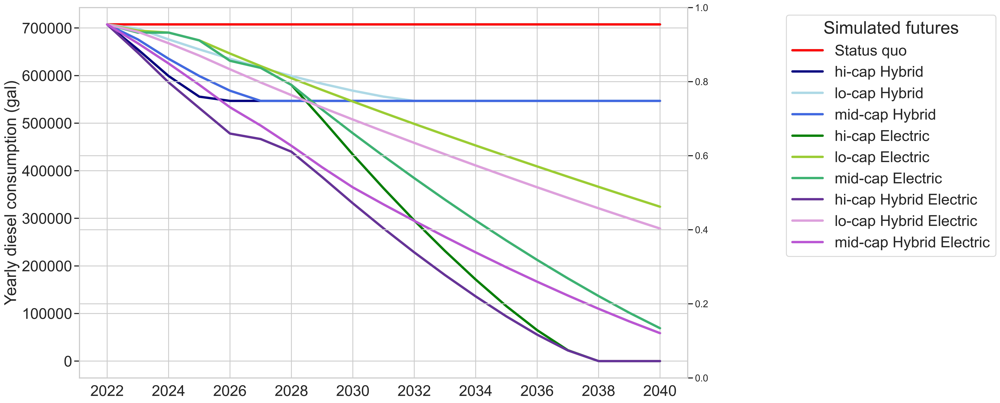

In [202]:
plt.figure(figsize=(25, 10), dpi=400)

custom_palette = {
    "Status quo": "black",
    "lo-cap Hybrid": "lightcoral",
    "mid-cap Hybrid": "indianred",
    "hi-cap Hybrid": "red",
    "lo-cap Hybrid Electric": "aqua",
    "mid-cap Hybrid Electric": "royalblue",
    "hi-cap Hybrid Electric": "navy",
    "lo-cap Electric": "yellowgreen",
    "mid-cap Electric": "mediumseagreen",
    "hi-cap Electric": "green"
}


custom_palette = {
    "Status quo": "red",
    "lo-cap Hybrid": "lightblue",
    "mid-cap Hybrid": "royalblue",
    "hi-cap Hybrid": "navy",
    "lo-cap Hybrid Electric": "plum",
    "mid-cap Hybrid Electric": "mediumorchid",
    "hi-cap Hybrid Electric": "rebeccapurple",
    "lo-cap Electric": "yellowgreen",
    "mid-cap Electric": "mediumseagreen",
    "hi-cap Electric": "green"
}

# Create the primary y-axis
ax = plt.gca()

# Use a loop to plot each category with its unique marker and color
for label in unique_labels:
    subset = final_df[final_df['Label'] == label]
    sns.lineplot(data=subset, x='Year', y='YearlyResult', label=label, dashes=False, 
                 color=custom_palette[label], linewidth = 4, ax=ax)

# Add titles and labels for primary y-axis
ax.set_xlabel('', fontsize=28)
ax.set_ylabel('Yearly diesel consumption (gal)', fontsize=28)
ax.legend(title='Simulated futures', bbox_to_anchor=(1.15, 1), loc='upper left', fontsize=26, title_fontsize=30)
ax.tick_params(axis='both', which='major', labelsize=26)

# Create secondary y-axis
ax2 = ax.twinx()

# Plot CO2 data on the secondary y-axis. I'm using a dashed line here, but you can customize as needed.
#for label in unique_labels:
#    subset = final_df[final_df['Label'] == label]
#    sns.lineplot(data=subset, x='Year', y='CO2', dashes=True, color=custom_palette[label], ax=ax2, linewidth=2.5, legend=False)


primary_ticks = ax.get_yticks()
#conversion_factor = 0.01
## Calculate secondary axis ticks and limits
#secondary_ticks = primary_ticks * conversion_factor
#primary_limits = ax.get_ylim()
#secondary_limits = (primary_limits[0] * conversion_factor, primary_limits[1] * conversion_factor)


# Set secondary axis ticks and limits
#ax2.set_yticks(secondary_ticks)
#ax2.set_ylim(secondary_limits)
#ax2.set_ylabel('Yearly emissions (tCO2e)', fontsize=30)
#ax2.tick_params(axis='y', which='major', labelsize=26)

ax.grid(True)
#ax2.grid(False) 

plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(2))  # or 1 for every year
plt.gca().xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))

# Save and display the plot
plt.tight_layout()
plt.savefig(r'../../figures/yearly-diesel-consumption-and-emissions.png', dpi=400)
plt.show()


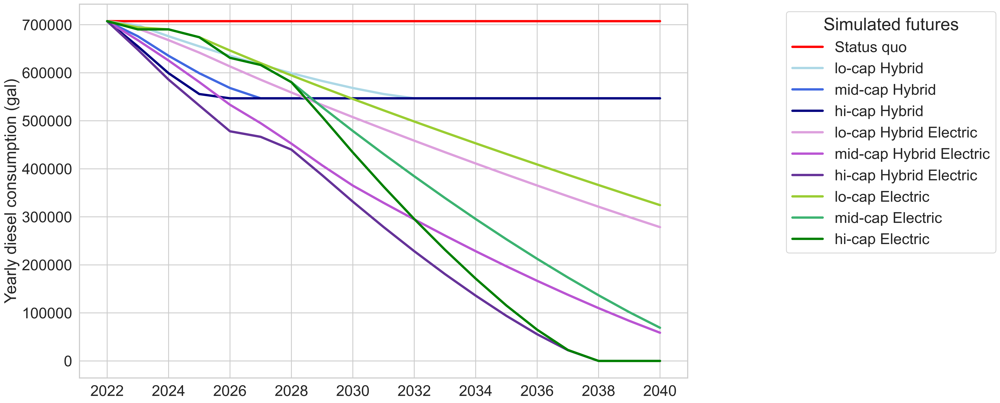

In [203]:
# List of unique labels in the desired order
unique_labels = ["Status quo", "lo-cap Hybrid", "mid-cap Hybrid", "hi-cap Hybrid",
                 "lo-cap Hybrid Electric", "mid-cap Hybrid Electric", "hi-cap Hybrid Electric",
                 "lo-cap Electric", "mid-cap Electric", "hi-cap Electric"]

# Custom palette
custom_palette = {
    "Status quo": "red",
    "lo-cap Hybrid": "lightblue",
    "mid-cap Hybrid": "royalblue",
    "hi-cap Hybrid": "navy",
    "lo-cap Hybrid Electric": "plum",
    "mid-cap Hybrid Electric": "mediumorchid",
    "hi-cap Hybrid Electric": "rebeccapurple",
    "lo-cap Electric": "yellowgreen",
    "mid-cap Electric": "mediumseagreen",
    "hi-cap Electric": "green"
}

plt.figure(figsize=(25, 10), dpi=400)

# Create the primary y-axis
ax = plt.gca()

# Use a loop to plot each category with its unique marker and color
for label in unique_labels:
    subset = final_df[final_df['Label'] == label]
    sns.lineplot(data=subset, x='Year', y='YearlyResult', label=label, dashes=False,
                 color=custom_palette[label], linewidth=4, ax=ax)

# Add titles and labels for primary y-axis
ax.set_xlabel('', fontsize=28)
ax.set_ylabel('Yearly diesel consumption (gal)', fontsize=28)

# Create a custom legend
handles, _ = ax.get_legend_handles_labels()
ordered_handles = [handles[unique_labels.index(label)] for label in unique_labels]
ax.legend(ordered_handles, unique_labels, title='Simulated futures', bbox_to_anchor=(1.15, 1), loc='upper left', fontsize=26, title_fontsize=30)

ax.tick_params(axis='both', which='major', labelsize=26)

plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(2))  # or 1 for every year
plt.gca().xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))

ax.grid(True)

# Save and display the plot
plt.tight_layout()
plt.savefig(r'../../figures/yearly-diesel-consumption-and-emissions.png', dpi=400)
plt.show()

In [204]:
final_df['YearlyResult100000gals']= final_df['YearlyResult']/100000

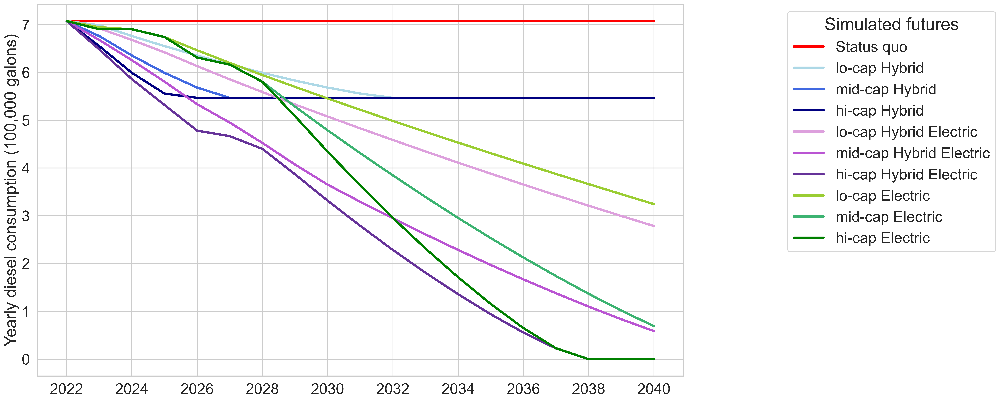

In [205]:
plt.figure(figsize=(25, 10), dpi=400)

# Create the primary y-axis
ax = plt.gca()
    
# Use a loop to plot each category with its unique marker and color
for label in unique_labels:
    subset = final_df[final_df['Label'] == label]
    sns.lineplot(data=subset, x='Year', y='YearlyResult100000gals', label=label, dashes=False,
                 color=custom_palette[label], linewidth=4, ax=ax)

# Add titles and labels for primary y-axis
ax.set_xlabel('', fontsize=28)
ax.set_ylabel('Yearly diesel consumption (100,000 galons)', fontsize=28)
ax.legend(title='Simulated futures', bbox_to_anchor=(1.15, 1), loc='upper left', fontsize=26, title_fontsize=30)
ax.tick_params(axis='both', which='major', labelsize=26)

plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(2))  # or 1 for every year
plt.gca().xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))

# Save and display the plot
plt.tight_layout()
plt.savefig(r'../../figures/yearly-diesel-consumption-and-emissions.png', dpi=400)
plt.show()


In [206]:
final_df['Label'].unique()

array(['Status quo', 'hi-cap Hybrid', 'lo-cap Hybrid', 'mid-cap Hybrid',
       'hi-cap Electric', 'lo-cap Electric', 'mid-cap Electric',
       'hi-cap Hybrid Electric', 'lo-cap Hybrid Electric',
       'mid-cap Hybrid Electric'], dtype=object)

In [207]:
final_df['Label'] = final_df['Label'].replace('hi-cap+Electric', 'hi-cap Electric')
final_df['Label'] = final_df['Label'].replace('hi-cap Hybrid Electric', 'hi-cap Hybrid+Electric')
final_df['Label'] = final_df['Label'].replace('mid-cap Hybrid Electric', 'mid-cap Hybrid+Electric')
final_df['Label'] = final_df['Label'].replace('lo-cap Hybrid Electric', 'lo-cap Hybrid+Electric')
final_df['Label'].unique()

array(['Status quo', 'hi-cap Hybrid', 'lo-cap Hybrid', 'mid-cap Hybrid',
       'hi-cap Electric', 'lo-cap Electric', 'mid-cap Electric',
       'hi-cap Hybrid+Electric', 'lo-cap Hybrid+Electric',
       'mid-cap Hybrid+Electric'], dtype=object)

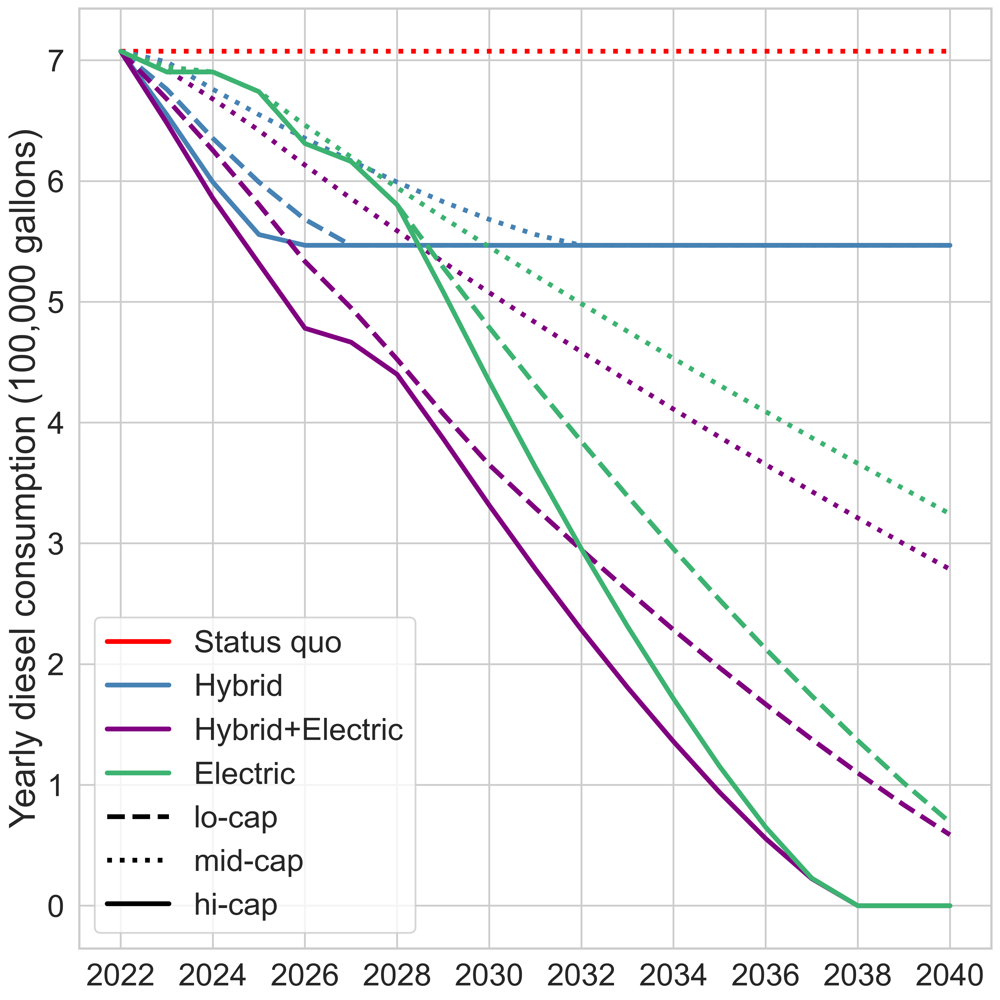

In [208]:
import matplotlib.lines as mlines

unique_labels = ["Status quo", "lo-cap Hybrid", "mid-cap Hybrid", "hi-cap Hybrid",
                 "lo-cap Hybrid+Electric", "mid-cap Hybrid+Electric", "hi-cap Hybrid+Electric",
                 "lo-cap Electric", "mid-cap Electric", "hi-cap Electric"]

# Updated custom palette and custom linestyles from the second plot
custom_palette = {
    'Status quo': 'red',
    'lo-cap Hybrid': 'steelblue',
    'mid-cap Hybrid': 'steelblue',
    'hi-cap Hybrid': 'steelblue',
    'lo-cap Hybrid+Electric': 'purple',
    'mid-cap Hybrid+Electric': 'purple',
    'hi-cap Hybrid+Electric': 'purple',
    'lo-cap Electric': 'mediumseagreen',
    'mid-cap Electric': 'mediumseagreen',
    'hi-cap Electric': 'mediumseagreen'
}

custom_linestyles = {
    'Status quo': 'dotted',
    'lo-cap Hybrid': 'dotted',
    'lo-cap Hybrid+Electric': 'dotted',
    'lo-cap Electric': 'dotted',
    'mid-cap Hybrid': 'dashed',
    'mid-cap Hybrid+Electric': 'dashed',
    'mid-cap Electric': 'dashed',
    'hi-cap Hybrid': 'solid',
    'hi-cap Hybrid+Electric': 'solid',
    'hi-cap Electric': 'solid',
}

# Plotting code modification
plt.figure(figsize=(12, 12), dpi=400)
ax = plt.gca()

# Use a loop to plot each category with its unique marker, color, and linestyle
for label in unique_labels:
    subset = final_df[final_df['Label'] == label]
    sns.lineplot(data=subset, x='Year', y='YearlyResult100000gals', label=label,
                 color=custom_palette[label], linestyle=custom_linestyles[label], linewidth=4, ax=ax)

# Adjust the legend, titles, and labels to match the style
ax.set_xlabel('', fontsize=30)
ax.set_ylabel('Yearly diesel consumption (100,000 gallons)', fontsize=30)
#ax.legend(title='Simulated futures', bbox_to_anchor=(1.15, 1), loc='upper left', fontsize=26, title_fontsize=30)
ax.tick_params(axis='both', which='major', labelsize=26)

# Creating custom legend handles
# For colors
hybrid_handle = mlines.Line2D([], [], color='steelblue', label='Hybrid', linewidth=4)
hybrid_electric_handle = mlines.Line2D([], [], color='purple', label='Hybrid+Electric', linewidth=4)
electric_handle = mlines.Line2D([], [], color='mediumseagreen', label='Electric', linewidth=4)
status_quo_handle = mlines.Line2D([], [], color='red', label='Status quo', linewidth=4)


# For line patterns
lo_cap_handle = mlines.Line2D([], [], color='black', linestyle='dashed', label='lo-cap', linewidth=4)
mid_cap_handle = mlines.Line2D([], [], color='black', linestyle='dotted', label='mid-cap', linewidth=4)
hi_cap_handle = mlines.Line2D([], [], color='black', linestyle='solid', label='hi-cap', linewidth=4)


# For 'Status quo'
#status_quo_handle = mlines.Line2D([], [], color='red', linestyle='solid', label='Status quo', linewidth=4)

plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(2))  # or 1 for every year
plt.gca().xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))

# Add the legend to the plot
plt.legend(handles=[status_quo_handle, hybrid_handle, hybrid_electric_handle, electric_handle, 
                    lo_cap_handle, mid_cap_handle, hi_cap_handle], loc='best', fontsize=26)
# Save and display the plot
plt.tight_layout()
plt.savefig(r'../../figures/yearly-diesel-consumption-and-emissions.png', dpi=400)
plt.show()


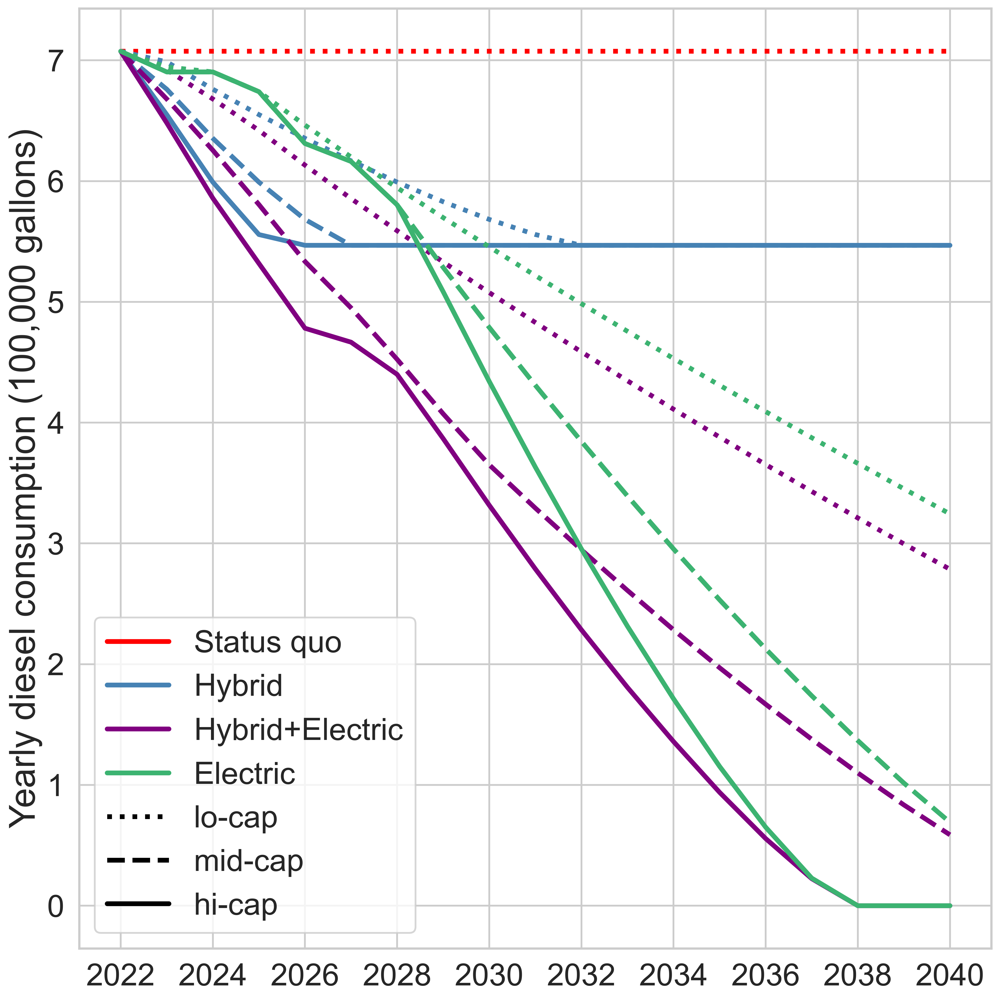

In [209]:
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import seaborn as sns

# Define unique labels
unique_labels = ["Status quo", "lo-cap Hybrid", "mid-cap Hybrid", "hi-cap Hybrid",
                 "lo-cap Hybrid+Electric", "mid-cap Hybrid+Electric", "hi-cap Hybrid+Electric",
                 "lo-cap Electric", "mid-cap Electric", "hi-cap Electric"]

# Define custom palette and line styles
custom_palette = {
    'Status quo': 'red',
    'lo-cap Hybrid': 'steelblue',
    'mid-cap Hybrid': 'steelblue',
    'hi-cap Hybrid': 'steelblue',
    'lo-cap Hybrid+Electric': 'purple',
    'mid-cap Hybrid+Electric': 'purple',
    'hi-cap Hybrid+Electric': 'purple',
    'lo-cap Electric': 'mediumseagreen',
    'mid-cap Electric': 'mediumseagreen',
    'hi-cap Electric': 'mediumseagreen'
}

custom_linestyles = {
    'Status quo': 'dotted',
    'lo-cap Hybrid': 'dotted',
    'lo-cap Hybrid+Electric': 'dotted',
    'lo-cap Electric': 'dotted',
    'mid-cap Hybrid': 'dashed',
    'mid-cap Hybrid+Electric': 'dashed',
    'mid-cap Electric': 'dashed',
    'hi-cap Hybrid': 'solid',
    'hi-cap Hybrid+Electric': 'solid',
    'hi-cap Electric': 'solid',
}

# Define percentage changes for each future scenario
percentage_changes = {
    "Status quo": "0%",
    "lo-cap Hybrid": "-14%",
    "mid-cap Hybrid": "-18%",
    "hi-cap Hybrid": "-19%",
    "lo-cap Hybrid+Electric": "-22%",
    "mid-cap Hybrid+Electric": "-38%",
    "hi-cap Hybrid+Electric": "-45%",
    "lo-cap Electric": "-18%",
    "mid-cap Electric": "-26%",
    "hi-cap Electric": "-32%"
}

# Custom y-offset adjustments to avoid overlap
y_offsets = {
    "Status quo": 10,
    "lo-cap Hybrid": 10,
    "mid-cap Hybrid": -10,  # Move -18% slightly downwards
    "hi-cap Hybrid": -30,  # Move -19% slightly downwards
    "lo-cap Hybrid+Electric": 10,
    "mid-cap Hybrid+Electric": -10,
    "hi-cap Hybrid+Electric": -15,
    "lo-cap Electric": 10,
    "mid-cap Electric": -10,
    "hi-cap Electric": 15
}

# Plotting
plt.figure(figsize=(12, 12), dpi=400)
ax = plt.gca()

# Plot each line and annotate
for label in unique_labels:
    subset = final_df[final_df['Label'] == label]
    line = sns.lineplot(data=subset, x='Year', y='YearlyResult100000gals', label=label,
                        color=custom_palette[label], linestyle=custom_linestyles[label], linewidth=4, ax=ax)
    
    ## Get last data point for annotation
    #last_point = subset.iloc[-1]
    #ax.annotate(percentage_changes[label],
    #            (last_point['Year'], last_point['YearlyResult100000gals']),
    #            textcoords="offset points",
    #            xytext=(15, y_offsets[label]),  # Adjust y-offset dynamically
    #            ha='left', fontsize=22, color=custom_palette[label])

# Adjust labels
ax.set_xlabel('', fontsize=30)
ax.set_ylabel('Yearly diesel consumption (100,000 gallons)', fontsize=30)
ax.tick_params(axis='both', which='major', labelsize=26)

# Creating custom legend handles
hybrid_handle = mlines.Line2D([], [], color='steelblue', label='Hybrid', linewidth=4)
hybrid_electric_handle = mlines.Line2D([], [], color='purple', label='Hybrid+Electric', linewidth=4)
electric_handle = mlines.Line2D([], [], color='mediumseagreen', label='Electric', linewidth=4)
status_quo_handle = mlines.Line2D([], [], color='red', label='Status quo', linewidth=4)

lo_cap_handle = mlines.Line2D([], [], color='black', linestyle='dotted', label='lo-cap', linewidth=4)
mid_cap_handle = mlines.Line2D([], [], color='black', linestyle='dashed', label='mid-cap', linewidth=4)
hi_cap_handle = mlines.Line2D([], [], color='black', linestyle='solid', label='hi-cap', linewidth=4)

plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(2))  # or 1 for every year
plt.gca().xaxis.set_major_formatter(ticker.FormatStrFormatter('%d'))

# Add the legend to the plot
plt.legend(handles=[status_quo_handle, hybrid_handle, hybrid_electric_handle, electric_handle, 
                    lo_cap_handle, mid_cap_handle, hi_cap_handle], loc='best', fontsize=26)

# Save and display the plot
plt.tight_layout()
plt.savefig(r'../../figures/yearly-diesel-consumption-and-emissions.png', dpi=400)
plt.show()


In [210]:
final_df.loc[final_df['Year']==2035]

,Year,Result,Scenario,Strategy,dist_BEB,dist_CDB,dist_HEB,Label,YearlyResult,Yearly_dist_CDB,Yearly_dist_HEB,Yearly_dist_BEB,CO2e_CDB,CO2e_HEB,CO2e,YearlyResult100000gals
13,2035,2738.750000,c,SQ,674.998976,10965.000000,899.999000,Status quo,707460.738888,2.832426e+06,2.324834e+05,1.743625e+05,9155.839172,619.833953,9775.673124,7.074607
32,2035,2116.845970,h,FH,674.972509,0.000000,11865.916477,hi-cap Hybrid,546813.478398,0.000000e+00,3.065147e+06,1.743557e+05,0.000000,8172.117871,8172.117871,5.468135
51,2035,2116.813327,l,FH,674.981434,0.000000,11865.907552,lo-cap Hybrid,546805.046320,0.000000e+00,3.065144e+06,1.743580e+05,0.000000,8172.111724,8172.111724,5.468050
70,2035,2116.836577,m,FH,674.986589,0.000000,11865.902397,mid-cap Hybrid,546811.052051,0.000000e+00,3.065143e+06,1.743593e+05,0.000000,8172.108174,8172.108174,5.468111
89,2035,446.530395,h,FE,9494.953385,2146.093969,899.841633,hi-cap Electric,115345.585840,5.543687e+05,2.324428e+05,2.452691e+06,1792.001024,619.725573,2411.726597,1.153456
108,2035,1668.261230,l,FE,4364.984626,7275.928168,899.976192,lo-cap Electric,430937.224019,1.879483e+06,2.324775e+05,1.127542e+06,6075.442602,619.818245,6695.260846,4.309372
127,2035,980.414757,m,FE,7064.914879,4575.975888,899.998219,mid-cap Electric,253256.028675,1.182044e+06,2.324832e+05,1.824975e+06,3820.966647,619.833415,4440.800062,2.532560
146,2035,363.367102,h,BM,9494.999803,0.000000,3045.889183,hi-cap Hybrid+Electric,93863.243742,0.000000e+00,7.867995e+05,2.452703e+06,0.000000,2097.719588,2097.719588,0.938632
165,2035,1502.140203,l,BM,4319.951566,4621.132639,3599.804781,lo-cap Hybrid+Electric,388025.638797,1.193709e+06,9.298843e+05,1.115909e+06,3858.672798,2479.204117,6337.876916,3.880256
184,2035,762.840715,m,BM,7064.966093,0.000000,5475.922893,mid-cap Hybrid+Electric,197053.347779,0.000000e+00,1.414514e+06,1.824988e+06,0.000000,3771.296336,3771.296336,1.970533


In [211]:
# Group by 'Label' and sum 'Result'
summed_results = final_df.groupby('Label')['YearlyResult'].sum().reset_index()

# Find the sum of 'Result' for 'Status quo' label
do_nothing_value = summed_results[summed_results['Label'] == 'Status quo']['YearlyResult'].values[0]

# Compute % decrease relative to 'Status quo'
summed_results['% Decrease'] = 100 * (do_nothing_value - summed_results['YearlyResult']) / do_nothing_value

summed_results

,Label,YearlyResult,% Decrease
0,Status quo,1.344175e+07,0.000000
1,hi-cap Electric,6.796995e+06,49.433716
2,hi-cap Hybrid,1.071956e+07,20.251810
3,hi-cap Hybrid+Electric,5.572264e+06,58.545114
4,lo-cap Electric,9.954710e+06,25.941881
5,lo-cap Hybrid,1.121670e+07,16.553305
6,lo-cap Hybrid+Electric,9.290610e+06,30.882461
7,mid-cap Electric,7.994369e+06,40.525848
8,mid-cap Hybrid,1.084165e+07,19.343517
9,mid-cap Hybrid+Electric,6.702125e+06,50.139507


C:\Users\Mahsa\AppData\Local\Temp\ipykernel_48904\1301743724.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Label', y='YearlyResult', data=summed_results, palette='viridis')


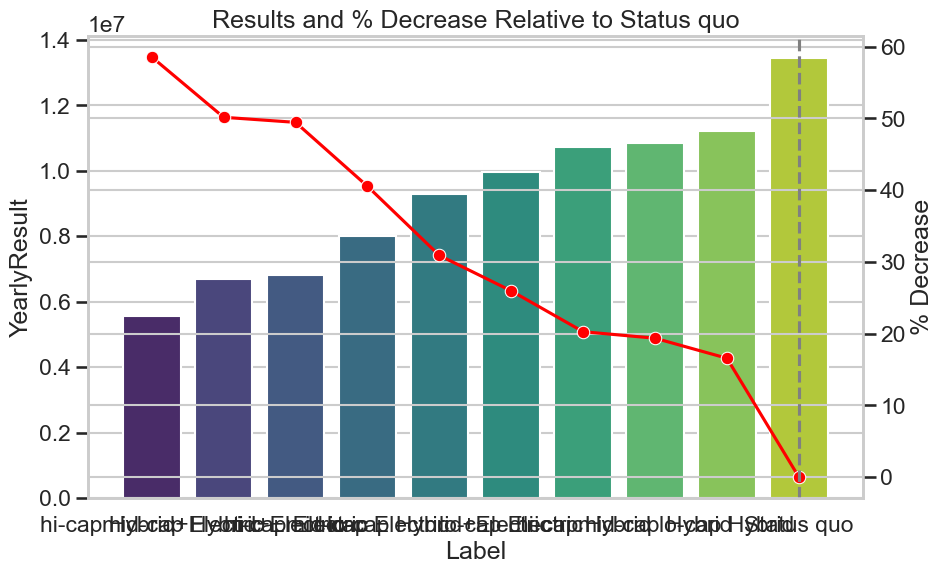

In [212]:
# Group by 'Label' and sum 'Result'
summed_results = final_df.groupby('Label')['YearlyResult'].sum().reset_index()

# Compute % decrease relative to 'Status quo'
do_nothing_value = summed_results[summed_results['Label'] == 'Status quo']['YearlyResult'].values[0]
summed_results['% Decrease'] = 100 * (do_nothing_value - summed_results['YearlyResult']) / do_nothing_value

# Order dataframe based on 'Result'
summed_results = summed_results.sort_values('YearlyResult')

# Plot
plt.figure(figsize=(10, 6))

# Bar plot
sns.barplot(x='Label', y='YearlyResult', data=summed_results, palette='viridis')

# Line plot for % Decrease
ax2 = plt.gca().twinx()
sns.lineplot(x='Label', y='% Decrease', data=summed_results, ax=ax2, color='red', marker="o")

# Highlight 'Status quo'
plt.axvline(x=summed_results['Label'].tolist().index('Status quo'), color='grey', linestyle='--')

# Legends and titles
plt.title('Results and % Decrease Relative to Status quo')
plt.gca().set(ylabel='% Decrease')
plt.show()

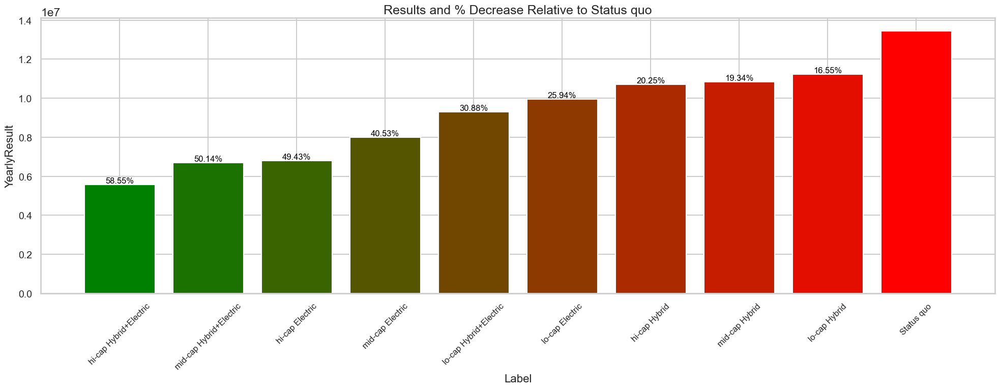

In [213]:
# Group by 'Label' and sum 'Result'
mean_results = final_df.groupby('Label')['YearlyResult'].sum().reset_index()

# Compute % decrease relative to 'Status quo'
do_nothing_value = mean_results[mean_results['Label'] == 'Status quo']['YearlyResult'].values[0]
mean_results['% Decrease'] = 100 * (do_nothing_value - mean_results['YearlyResult']) / do_nothing_value

# Order dataframe based on 'Result'
mean_results = mean_results.sort_values('YearlyResult')

# Create custom colormap
colors = ["green", "red"]  # Reversed the order for proper gradient
cmap = LinearSegmentedColormap.from_list('custom', colors, N=len(mean_results))

# Derive bar colors from colormap
bar_colors = [cmap(i) for i in np.linspace(0, 1, len(mean_results))]

# Plot
plt.figure(figsize=(20, 8))
bars = plt.bar(mean_results['Label'], mean_results['YearlyResult'], color=bar_colors)

# Annotations on top of each bar
for idx, rect in enumerate(bars):
    height = rect.get_height()
    if mean_results.iloc[idx]['Label'] != 'Status quo':
        plt.annotate(f"{mean_results.iloc[idx]['% Decrease']:.2f}%",
                     xy=(rect.get_x() + rect.get_width() / 2, height + 2),  # Adding a small offset on y for clarity
                     ha='center', va='bottom', fontsize=12, color='black')

# Style adjustments
plt.xticks(fontsize=12, rotation=45)  # Increased font size and rotated ticks by 45 degrees
plt.yticks(fontsize=14)
plt.xlabel('Label', fontsize=16)
plt.ylabel('YearlyResult', fontsize=16)
plt.title('Results and % Decrease Relative to Status quo', fontsize=18)
plt.tight_layout()
plt.show()


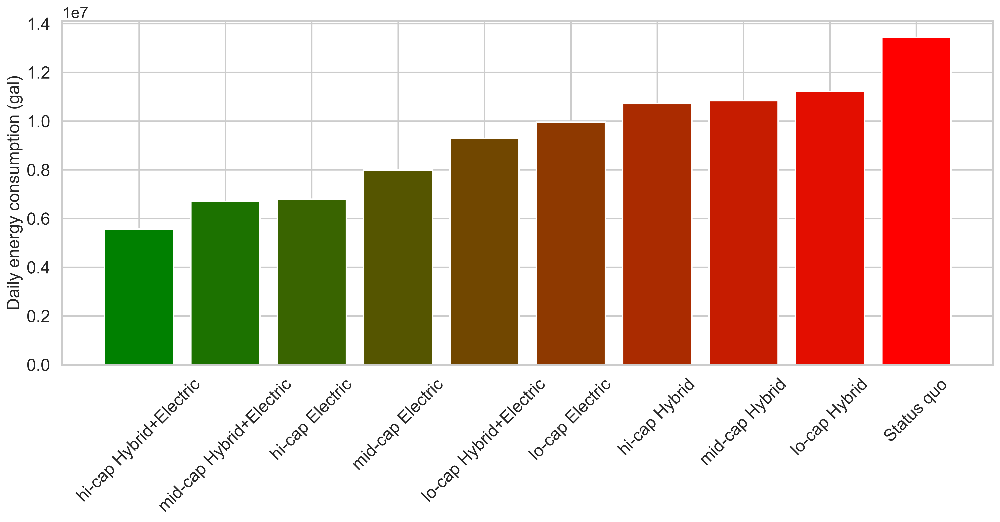

In [214]:
# Group by 'Label' and sum 'Result'
mean_results = final_df.groupby('Label')['YearlyResult'].sum().reset_index()

# Compute % decrease relative to 'Status quo'
do_nothing_value = mean_results[mean_results['Label'] == 'Status quo']['YearlyResult'].values[0]
mean_results['% Decrease'] = 100 * (do_nothing_value - mean_results['YearlyResult']) / do_nothing_value

# Order dataframe based on 'Result'
mean_results = mean_results.sort_values('YearlyResult')

# Create custom colormap
colors = ["green", "red"]  # Reversed the order for proper gradient
cmap = LinearSegmentedColormap.from_list('custom', colors, N=len(mean_results))

# Derive bar colors from colormap
bar_colors = [cmap(i) for i in np.linspace(0, 1, len(mean_results))]

# Plot
plt.figure(figsize=(15, 8), dpi=400)  # Increased size
bars = plt.bar(mean_results['Label'], mean_results['YearlyResult'], color=bar_colors)

# Style adjustments
plt.xticks(fontsize=18, rotation=45)  # Increased font size and rotated ticks by 45 degrees
plt.yticks(fontsize=18)  # Increased font size
#plt.xlabel('Label', fontsize=20)  # Increased font size
plt.ylabel('Daily energy consumption (gal)', fontsize=18)  # Increased font size
#plt.title('Results and % Decrease Relative to Status quo', fontsize=24)  # Increased font size
# Save the plot
plt.tight_layout()
plt.savefig(r'../../figures/mean-diesel-consumption.png', dpi=400)  
plt.show()


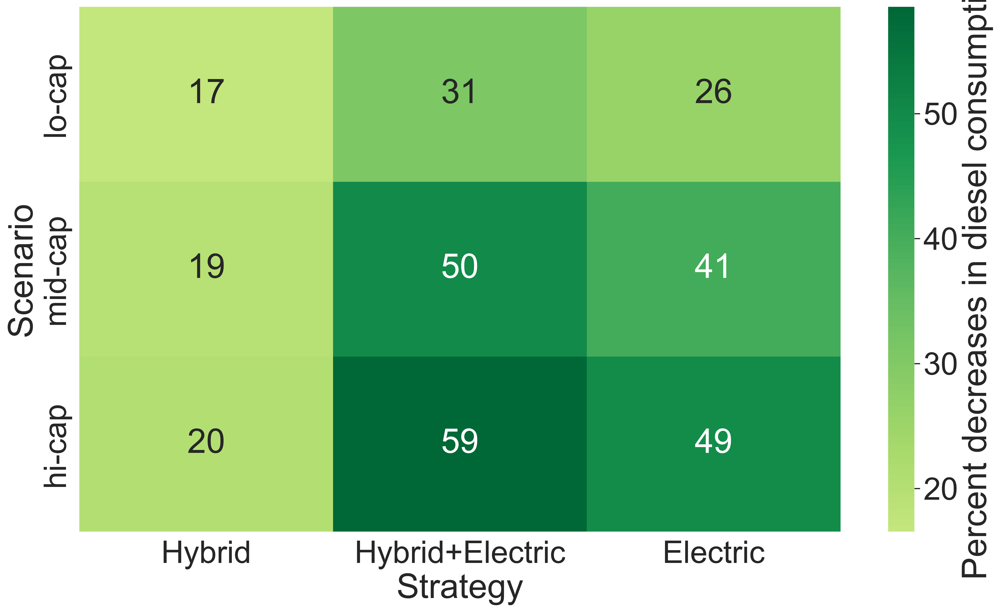

In [215]:
# Pivot dataframe to get desired structure
aggregated_df = final_df.groupby(['Scenario', 'Strategy'])['YearlyResult'].sum().reset_index().copy()

# Mapping for Scenario and Strategy columns
scenario_mapping = {
    'l': 'lo-cap',
    'm': 'mid-cap',
    'h': 'hi-cap',
    'c': 'lo-cap'   
}

strategy_mapping = {
    'SQ': 'Status quo',
    'FH': 'Hybrid',
    'BM': 'Hybrid+Electric',
    'FE': 'Electric'
}

# Replace values in the columns
aggregated_df['Scenario'] = aggregated_df['Scenario'].replace(scenario_mapping)
aggregated_df['Strategy'] = aggregated_df['Strategy'].replace(strategy_mapping)

#pivot_df = aggregated_df.pivot('Scenario', 'Strategy', 'YearlyResult')
pivot_df = aggregated_df.pivot(index='Scenario', columns='Strategy', values='YearlyResult')

column_order = ['Status quo', 'Hybrid', 'Hybrid+Electric', 'Electric']
pivot_df = pivot_df[column_order]


# Compute %Decrease
reference_value = pivot_df.loc['lo-cap', 'Status quo']

pivot_df = ((reference_value - pivot_df ) / reference_value) * 100

# Drop Scenario 'c' and Strategy 'Status quo'
#pivot_df = pivot_df.drop('c', axis=0)
pivot_df = pivot_df.drop('Status quo', axis=1)

# Find min and max percentage decrease values
vmin_value, vmax_value = pivot_df.min().min(), pivot_df.max().max()

# Define the desired order for the y-axis
y_axis_order = ['lo-cap', 'mid-cap', 'hi-cap']

# Manually reorder the rows of the DataFrame based on the desired order
pivot_df = pivot_df.loc[y_axis_order]

# Plot heatmap
plt.figure(figsize=(18, 10), dpi=400)
sns.set(font_scale=3)
sns.heatmap(pivot_df, annot=True, fmt='.0f', cmap='RdYlGn', cbar_kws={'label': 'Percent decreases in diesel consumption'}, center=0, vmin=vmin_value, vmax=vmax_value)

#plt.title("Percentage Decrease Heatmap based on Scenario and Strategy")
plt.savefig(r'../../figures/decrease-diesel-heatmap.png', dpi=400)  

plt.show()


In [216]:
pivot_df

Strategy,Hybrid,Hybrid+Electric,Electric
Scenario,,,
lo-cap,16.553305,30.882461,25.941881
mid-cap,19.343517,50.139507,40.525848
hi-cap,20.251810,58.545114,49.433716


In [217]:
final_df.loc[final_df['Strategy'] == 'SQ', 'Scenario'] = 'l'
final_df

,Year,Result,Scenario,Strategy,dist_BEB,dist_CDB,dist_HEB,Label,YearlyResult,Yearly_dist_CDB,Yearly_dist_HEB,Yearly_dist_BEB,CO2e_CDB,CO2e_HEB,CO2e,YearlyResult100000gals
0,2022,2738.750000,l,SQ,674.998976,10965.0,899.999000,Status quo,707460.738888,2.832426e+06,2.324834e+05,1.743625e+05,9155.839172,619.833953,9775.673124,7.074607
1,2023,2738.750000,l,SQ,674.998976,10965.0,899.999000,Status quo,707460.738888,2.832426e+06,2.324834e+05,1.743625e+05,9155.839172,619.833953,9775.673124,7.074607
2,2024,2738.750000,l,SQ,674.998976,10965.0,899.999000,Status quo,707460.738888,2.832426e+06,2.324834e+05,1.743625e+05,9155.839172,619.833953,9775.673124,7.074607
3,2025,2738.750000,l,SQ,674.998976,10965.0,899.999000,Status quo,707460.738888,2.832426e+06,2.324834e+05,1.743625e+05,9155.839172,619.833953,9775.673124,7.074607
4,2026,2738.750000,l,SQ,674.998976,10965.0,899.999000,Status quo,707460.738888,2.832426e+06,2.324834e+05,1.743625e+05,9155.839172,619.833953,9775.673124,7.074607
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
185,2036,645.890019,m,BM,7739.991687,0.0,4800.897299,mid-cap Hybrid+Electric,166843.205944,0.000000e+00,1.240145e+06,1.999357e+06,0.000000,3306.402729,3306.402729,1.668432
186,2037,533.541676,m,BM,8414.971644,0.0,4125.917342,mid-cap Hybrid+Electric,137821.921839,0.000000e+00,1.065787e+06,2.173715e+06,0.000000,2841.540551,2841.540551,1.378219
187,2038,425.615739,m,BM,9089.875157,0.0,3451.013828,mid-cap Hybrid+Electric,109943.012423,0.000000e+00,8.914493e+05,2.348053e+06,0.000000,2376.731021,2376.731021,1.099430
188,2039,323.111088,m,BM,9764.998531,0.0,2775.890455,mid-cap Hybrid+Electric,83464.503435,0.000000e+00,7.170547e+05,2.522447e+06,0.000000,1911.770072,1911.770072,0.834645


In [218]:
# Aggregate CO2 by Scenario and Strategy
aggregated_df = final_df.groupby(['Scenario', 'Strategy'])['CO2e'].sum().reset_index()

# Rename the column to make it clear it's the aggregated value (optional)
aggregated_df.rename(columns={'CO2e': 'Total_CO2e'}, inplace=True)

# Display the result
aggregated_df

,Scenario,Strategy,Total_CO2e
0,h,BM,89315.688673
1,h,FE,101374.955740
2,h,FH,158789.987665
3,l,BM,141124.044906
4,l,FE,146410.322353
5,l,FH,164070.834343
6,l,SQ,185737.789365
7,m,BM,107997.665342
8,m,FE,120784.055640
9,m,FH,160072.311202


In [219]:
# Step 1: Find the baseline value
baseline_value = aggregated_df.loc[
    (aggregated_df['Scenario'] == 'l') & (aggregated_df['Strategy'] == 'SQ'),
    'Total_CO2e'
].values[0]

# Step 2: Calculate the relative CO2
aggregated_df['Total_CO2e_relative'] = baseline_value - aggregated_df['Total_CO2e']

# Display the updated dataframe
aggregated_df


,Scenario,Strategy,Total_CO2e,Total_CO2e_relative
0,h,BM,89315.688673,96422.100692
1,h,FE,101374.955740,84362.833625
2,h,FH,158789.987665,26947.801699
3,l,BM,141124.044906,44613.744459
4,l,FE,146410.322353,39327.467012
5,l,FH,164070.834343,21666.955022
6,l,SQ,185737.789365,0.000000
7,m,BM,107997.665342,77740.124022
8,m,FE,120784.055640,64953.733725
9,m,FH,160072.311202,25665.478163


In [220]:
# Step 1: Find the baseline value
baseline_value = aggregated_df.loc[
    (aggregated_df['Scenario'] == 'l') & (aggregated_df['Strategy'] == 'SQ'),
    'Total_CO2e'
].values[0]

# Step 2: Calculate the percentage reduction relative to the baseline
aggregated_df['Percent_Reduction_vs_SQ'] = (
    (baseline_value - aggregated_df['Total_CO2e']) / baseline_value
) * 100

# Display the updated dataframe
aggregated_df


,Scenario,Strategy,Total_CO2e,Total_CO2e_relative,Percent_Reduction_vs_SQ
0,h,BM,89315.688673,96422.100692,51.913023
1,h,FE,101374.955740,84362.833625,45.420393
2,h,FH,158789.987665,26947.801699,14.508519
3,l,BM,141124.044906,44613.744459,24.019746
4,l,FE,146410.322353,39327.467012,21.173649
5,l,FH,164070.834343,21666.955022,11.665346
6,l,SQ,185737.789365,0.000000,0.000000
7,m,BM,107997.665342,77740.124022,41.854770
8,m,FE,120784.055640,64953.733725,34.970662
9,m,FH,160072.311202,25665.478163,13.818124


In [291]:
# Improve the plot
df_emission = final_df.copy()

# Mapping for Scenario and Strategy columns
scenario_mapping = {
    'l': 'lo-cap',
    'm': 'mid-cap',
    'h': 'hi-cap',
}

strategy_mapping = {
    'SQ': 'Status quo',
    'FH': 'Hybrid',
    'BM': 'Hybrid+Electric',
    'FE': 'Electric'
}

# Replace values in the columns
df_emission['Scenario'] = df_emission['Scenario'].replace(scenario_mapping)
df_emission['Strategy'] = df_emission['Strategy'].replace(strategy_mapping)

df_emission['YearlyResult-1000gallons'] = df_emission['YearlyResult']/1000

pivot_df_emission = df_emission.pivot_table(values='YearlyResult-1000gallons', index='Scenario', columns='Strategy', aggfunc='sum')

# Reorder the columns of pivot_df_emission
column_order = ['Status quo', 'Hybrid', 'Hybrid+Electric', 'Electric']
pivot_df_emission = pivot_df_emission[column_order]

# Define the desired order for the y-axis
y_axis_order = ['hi-cap','mid-cap','lo-cap']

# Manually reorder the rows of the DataFrame based on the desired order
pivot_df_emission = pivot_df_emission.loc[y_axis_order]

vmin_value = pivot_df_emission.min().min()
vmax_value = pivot_df_emission.max().max()

# Set the aesthetics
sns.set_style("whitegrid")
sns.set_context("talk")

plt.figure(figsize=(18, 16))

# Create heatmap
sns.set(font_scale=3)
sns.heatmap(pivot_df_emission, annot=True, fmt='.0f', cmap='RdYlGn_r', cbar_kws={'label': 'Diesel consumption for year 2022-2035 (10000 galons)'}, vmin=vmin_value, vmax=vmax_value)

# Add titles and labels
# Uncomment these lines if you want to include titles and labels
#plt.title('CO2 Emission Heatmap', fontsize=20)
#plt.xlabel('Strategy', fontsize=40)
#plt.ylabel('Scenario', fontsize=40)
#plt.xticks(fontsize=32, rotation=45)
#plt.yticks(fontsize=32)

# Save the plot
plt.tight_layout()
plt.savefig(r'../../figures/diesel-total-heatmap.png', dpi=400)

# Display the plot
plt.show()


KeyError: "['Status quo'] not in index"

In [292]:
df_emission

,Year,Result,Scenario,Strategy,dist_BEB,dist_CDB,dist_HEB,Label,YearlyResult,Yearly_dist_CDB,Yearly_dist_HEB,Yearly_dist_BEB,CO2e_CDB,CO2e_HEB,CO2e,YearlyResult100000gals,% Decrease,YearlyResult-1000gallons
19,2022,2738.750000,hi-cap,Hybrid,674.998976,10965.000000,899.999000,hi-cap Hybrid,707460.738888,2.832426e+06,2.324834e+05,1.743625e+05,9155.839172,619.833953,9775.673124,7.074607,0.000000,707.460739
20,2023,2535.812907,hi-cap,Hybrid,674.996965,7666.020443,4199.871578,hi-cap Hybrid,655039.004235,1.980250e+06,1.084891e+06,1.743620e+05,6401.171934,2892.473215,9293.645149,6.550390,7.409844,655.039004
21,2024,2319.375537,hi-cap,Hybrid,674.999653,4365.924070,7499.965263,hi-cap Hybrid,599129.942973,1.127785e+06,1.937355e+06,1.743627e+05,3645.572150,5165.264755,8810.836904,5.991299,15.312623,599.129943
22,2025,2151.339705,hi-cap,Hybrid,674.996965,1066.046823,10799.845198,hi-cap Hybrid,555723.734366,2.753761e+05,2.789764e+06,1.743620e+05,890.155336,7437.909084,8328.064420,5.557237,21.448117,555.723734
23,2026,2116.845970,hi-cap,Hybrid,674.972509,0.000000,11865.916477,hi-cap Hybrid,546813.478398,0.000000e+00,3.065147e+06,1.743557e+05,0.000000,8172.117871,8172.117871,5.468135,22.707587,546.813478
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
185,2036,645.890019,mid-cap,Hybrid+Electric,7739.991687,0.000000,4800.897299,mid-cap Hybrid+Electric,166843.205944,0.000000e+00,1.240145e+06,1.999357e+06,0.000000,3306.402729,3306.402729,1.668432,76.416613,166.843206
186,2037,533.541676,mid-cap,Hybrid+Electric,8414.971644,0.000000,4125.917342,mid-cap Hybrid+Electric,137821.921839,0.000000e+00,1.065787e+06,2.173715e+06,0.000000,2841.540551,2841.540551,1.378219,80.518789,137.821922
187,2038,425.615739,mid-cap,Hybrid+Electric,9089.875157,0.000000,3451.013828,mid-cap Hybrid+Electric,109943.012423,0.000000e+00,8.914493e+05,2.348053e+06,0.000000,2376.731021,2376.731021,1.099430,84.459489,109.943012
188,2039,323.111088,mid-cap,Hybrid+Electric,9764.998531,0.000000,2775.890455,mid-cap Hybrid+Electric,83464.503435,0.000000e+00,7.170547e+05,2.522447e+06,0.000000,1911.770072,1911.770072,0.834645,88.202242,83.464503


In [222]:
df_emission.to_csv(r'../../results/df_emission-ContiniuedTo2040.csv', index=False)

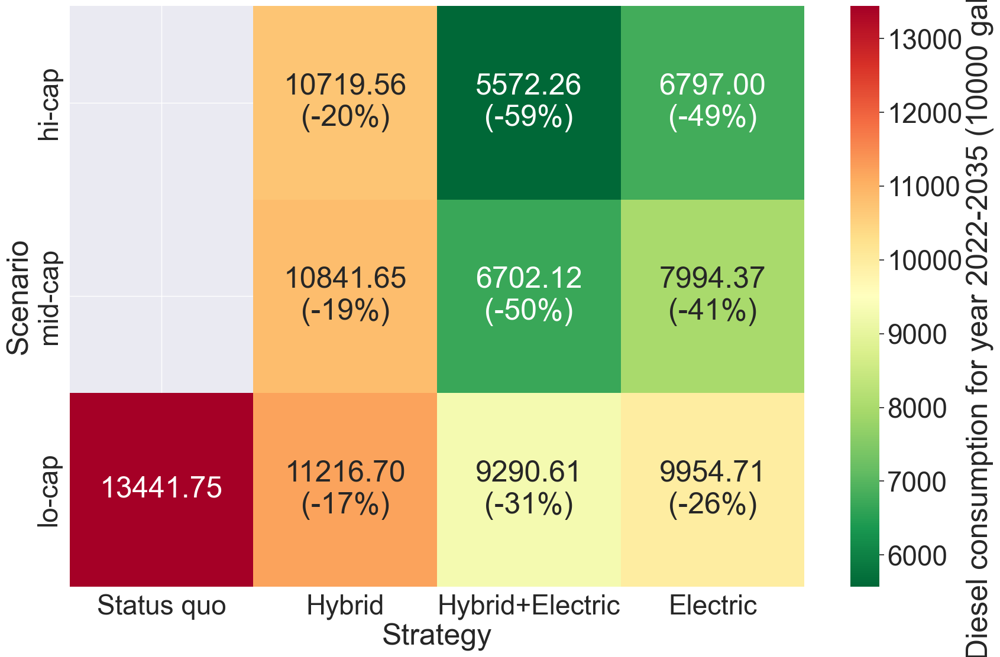

In [223]:
# Creating a pivot table for heatmap
pivot_df_emission_numeric = df_emission.pivot_table(values='YearlyResult-1000gallons', index='Scenario', columns='Strategy', aggfunc='sum')

# Initialize the annotations dataframe with the same indices and columns
annotations = pd.DataFrame(index=pivot_df_emission_numeric.index, columns=pivot_df_emission_numeric.columns)

# First, find the 'Status quo' value in the 'lo-cap' row
status_quo_value = pivot_df_emission_numeric.loc['lo-cap', 'Status quo']

# Now calculate the percentage decrease relative to the 'Status quo' value
for strategy in pivot_df_emission_numeric.columns:
    if strategy != 'Status quo':
        # Apply the percentage calculation to each strategy
        annotations[strategy] = pivot_df_emission_numeric[strategy].apply(
            lambda x: f"{x:.2f}\n({-(1 - x / status_quo_value) * 100:.0f}%)" if status_quo_value != 0 else f"{x:.2f}\n(N/A)"
        )
    else:
        # For 'Status quo', simply annotate with the value
        annotations[strategy] = pivot_df_emission_numeric[strategy].apply(lambda x: f"{x:.2f}")


# Reorder the columns and rows
pivot_df_emission_numeric = pivot_df_emission_numeric[['Status quo', 'Hybrid', 'Hybrid+Electric', 'Electric']]
pivot_df_emission_numeric = pivot_df_emission_numeric.loc[['hi-cap', 'mid-cap', 'lo-cap']]
annotations = annotations[['Status quo', 'Hybrid', 'Hybrid+Electric', 'Electric']]
annotations = annotations.loc[['hi-cap', 'mid-cap', 'lo-cap']]

# Setting minimum and maximum values for color bar
vmin_value = pivot_df_emission_numeric.min().min()
vmax_value = pivot_df_emission_numeric.max().max()

# Set the aesthetics
sns.set_style("whitegrid")
sns.set_context("talk")
plt.figure(figsize=(18, 12))

# Create heatmap with numeric values and annotate with formatted strings
sns.set(font_scale=3)
ax = sns.heatmap(pivot_df_emission_numeric, annot=annotations.values, fmt='', cmap='RdYlGn_r', cbar_kws={'label': 'Diesel consumption for year 2022-2035 (10000 gallons)'}, vmin=vmin_value, vmax=vmax_value)

# Add titles and labels
#plt.xlabel('Strategy', fontsize=16)
#plt.ylabel('Scenario', fontsize=16)
#plt.xticks(fontsize=14, rotation=45)
#plt.yticks(fontsize=14)

plt.tight_layout()
plt.show()

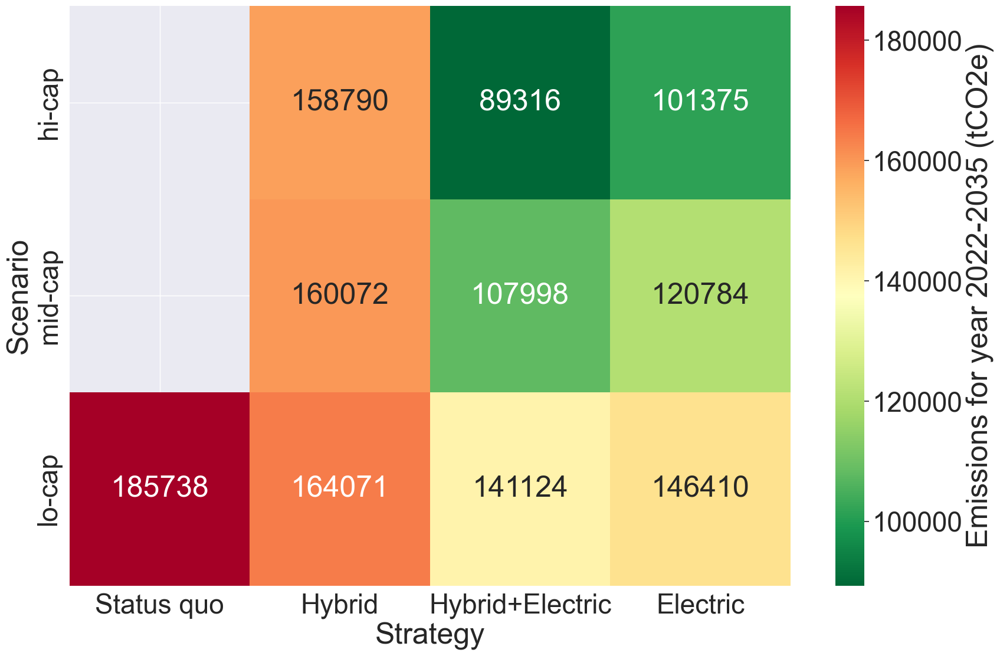

In [224]:
# Improve the plot
df_emission = final_df.copy()

# Mapping for Scenario and Strategy columns
scenario_mapping = {
    'l': 'lo-cap',
    'm': 'mid-cap',
    'h': 'hi-cap',
}

strategy_mapping = {
    'SQ': 'Status quo',
    'FH': 'Hybrid',
    'BM': 'Hybrid+Electric',
    'FE': 'Electric'
}

# Replace values in the columns
df_emission['Scenario'] = df_emission['Scenario'].replace(scenario_mapping)
df_emission['Strategy'] = df_emission['Strategy'].replace(strategy_mapping)

pivot_df_emission = df_emission.pivot_table(values='CO2e', index='Scenario', columns='Strategy', aggfunc='sum')

# Reorder the columns of pivot_df_emission
column_order = ['Status quo', 'Hybrid', 'Hybrid+Electric', 'Electric']
pivot_df_emission = pivot_df_emission[column_order]

# Define the desired order for the y-axis
y_axis_order = ['hi-cap','mid-cap','lo-cap']

# Manually reorder the rows of the DataFrame based on the desired order
pivot_df_emission = pivot_df_emission.loc[y_axis_order]

vmin_value = pivot_df_emission.min().min()
vmax_value = pivot_df_emission.max().max()

# Set the aesthetics
sns.set_style("whitegrid")
sns.set_context("talk")

plt.figure(figsize=(18, 12))

# Create heatmap
sns.set(font_scale=3)
sns.heatmap(pivot_df_emission, annot=True, fmt='.0f', cmap='RdYlGn_r', cbar_kws={'label': 'Emissions for year 2022-2035 (tCO2e)'}, vmin=vmin_value, vmax=vmax_value)

# Add titles and labels
# Uncomment these lines if you want to include titles and labels
#plt.title('CO2 Emission Heatmap', fontsize=20)
#plt.xlabel('Strategy', fontsize=40)
#plt.ylabel('Scenario', fontsize=40)
#plt.xticks(fontsize=32, rotation=45)
#plt.yticks(fontsize=32)

# Save the plot
plt.tight_layout()
plt.savefig(r'../../figures/co2-emission-heatmap.png', dpi=400)

# Display the plot
plt.show()


In [225]:
pivot_df_emission=pivot_df_emission/1000

In [226]:
pivot_df_emission

Strategy,Status quo,Hybrid,Hybrid+Electric,Electric
Scenario,,,,
hi-cap,NaN,158.789988,89.315689,101.374956
mid-cap,NaN,160.072311,107.997665,120.784056
lo-cap,185.737789,164.070834,141.124045,146.410322


In [227]:
df_emission['CO2e1000']=df_emission['CO2e']/1000

In [228]:
pivot_df_emission.to_pickle(r'../../results/pivot_df_emission-ContiniuedTo2040.pkl')

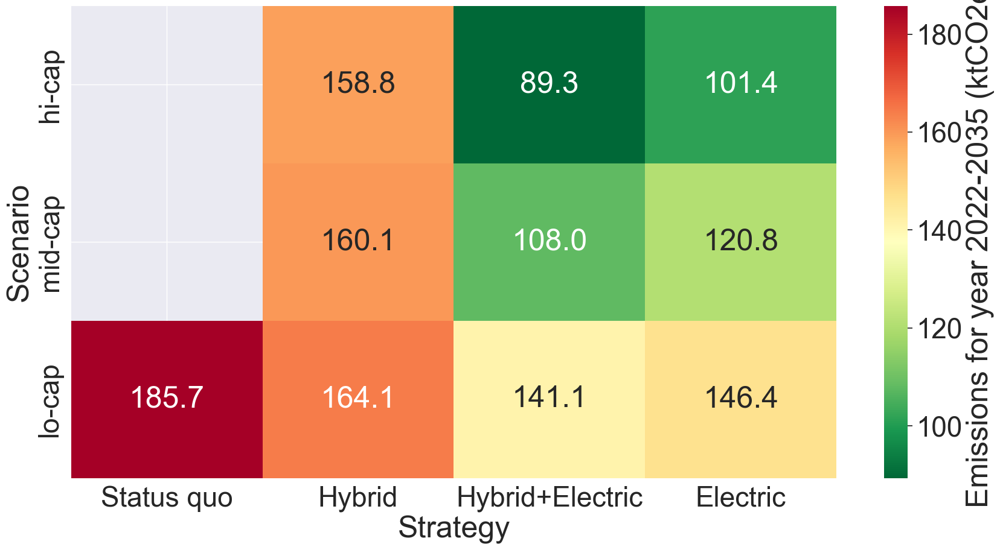

In [229]:
# Reorder the columns of pivot_df_emission
column_order = ['Status quo', 'Hybrid', 'Hybrid+Electric', 'Electric']
pivot_df_emission = pivot_df_emission[column_order]

# Define the desired order for the y-axis
y_axis_order = ['hi-cap','mid-cap','lo-cap']

# Manually reorder the rows of the DataFrame based on the desired order
pivot_df_emission = pivot_df_emission.loc[y_axis_order]

vmin_value = pivot_df_emission.min().min()
vmax_value = pivot_df_emission.max().max()

# Set the aesthetics
sns.set_style("whitegrid")
sns.set_context("talk")

plt.figure(figsize=(18, 10))

# Create heatmap
sns.set(font_scale=3)
sns.heatmap(pivot_df_emission, annot=True, fmt='.1f', cmap='RdYlGn_r', cbar_kws={'label': 'Emissions for year 2022-2035 (ktCO2e)'}, vmin=vmin_value, vmax=vmax_value)

# Add titles and labels
# Uncomment these lines if you want to include titles and labels
#plt.title('CO2 Emission Heatmap', fontsize=20)
#plt.xlabel('Strategy', fontsize=40)
#plt.ylabel('Scenario', fontsize=40)
#plt.xticks(fontsize=32, rotation=45)
#plt.yticks(fontsize=32)

# Save the plot
plt.tight_layout()
plt.savefig(r'../../figures/co2-emission-heatmap.png', dpi=400)

# Display the plot
plt.show()

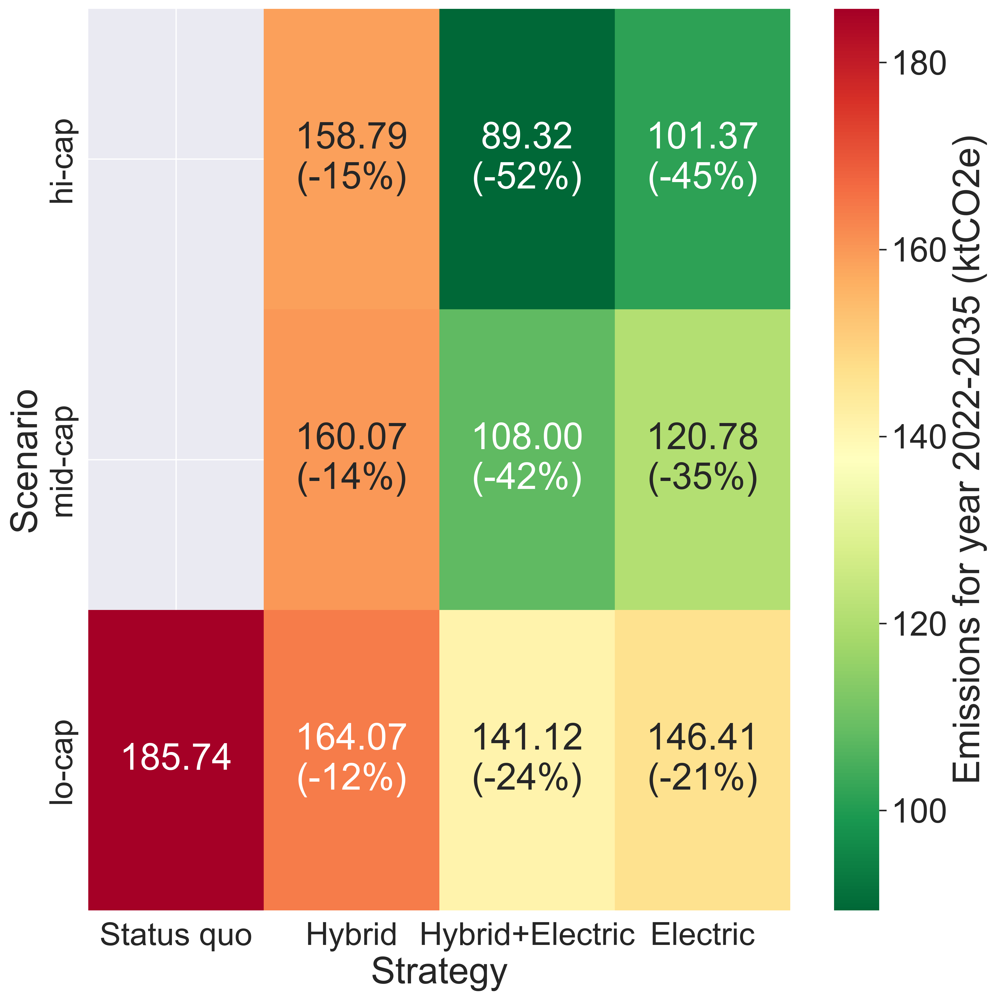

In [230]:
# Creating a pivot table for heatmap
pivot_df_emission_numeric = df_emission.pivot_table(values='CO2e1000', index='Scenario', columns='Strategy', aggfunc='sum')

# Initialize the annotations dataframe with the same indices and columns
annotations = pd.DataFrame(index=pivot_df_emission_numeric.index, columns=pivot_df_emission_numeric.columns)

# First, find the 'Status quo' value in the 'lo-cap' row
status_quo_value = pivot_df_emission_numeric.loc['lo-cap', 'Status quo']

# Now calculate the percentage decrease relative to the 'Status quo' value
for strategy in pivot_df_emission_numeric.columns:
    if strategy != 'Status quo':
        # Apply the percentage calculation to each strategy
        annotations[strategy] = pivot_df_emission_numeric[strategy].apply(
            lambda x: f"{x:.2f}\n({-(1 - x / status_quo_value) * 100:.0f}%)" if status_quo_value != 0 else f"{x:.2f}\n(N/A)"
        )
    else:
        # For 'Status quo', simply annotate with the value
        annotations[strategy] = pivot_df_emission_numeric[strategy].apply(lambda x: f"{x:.2f}")


# Reorder the columns and rows
pivot_df_emission_numeric = pivot_df_emission_numeric[['Status quo', 'Hybrid', 'Hybrid+Electric', 'Electric']]
pivot_df_emission_numeric = pivot_df_emission_numeric.loc[['hi-cap', 'mid-cap', 'lo-cap']]
annotations = annotations[['Status quo', 'Hybrid', 'Hybrid+Electric', 'Electric']]
annotations = annotations.loc[['hi-cap', 'mid-cap', 'lo-cap']]

# Setting minimum and maximum values for color bar
vmin_value = pivot_df_emission_numeric.min().min()
vmax_value = pivot_df_emission_numeric.max().max()

# Set the aesthetics
sns.set_style("whitegrid")
sns.set_context("talk")
plt.figure(figsize=(12, 12), dpi=400)

# Create heatmap with numeric values and annotate with formatted strings
sns.set(font_scale=2.5)
ax = sns.heatmap(pivot_df_emission_numeric, annot=annotations.values, fmt='', cmap='RdYlGn_r', cbar_kws={'label': 'Emissions for year 2022-2035 (ktCO2e)'}, vmin=vmin_value, vmax=vmax_value)

# Set axis labels and tick sizes
ax.set_xlabel('Strategy', fontsize=30)
ax.set_ylabel('Scenario', fontsize=30)
ax.set_xticklabels(ax.get_xticklabels(), fontsize=26, rotation=0)
ax.set_yticklabels(ax.get_yticklabels(), fontsize=26)

plt.tight_layout()
plt.show()

In [231]:
pivot_df_emission_numeric

Strategy,Status quo,Hybrid,Hybrid+Electric,Electric
Scenario,,,,
hi-cap,NaN,158.789988,89.315689,101.374956
mid-cap,NaN,160.072311,107.997665,120.784056
lo-cap,185.737789,164.070834,141.124045,146.410322


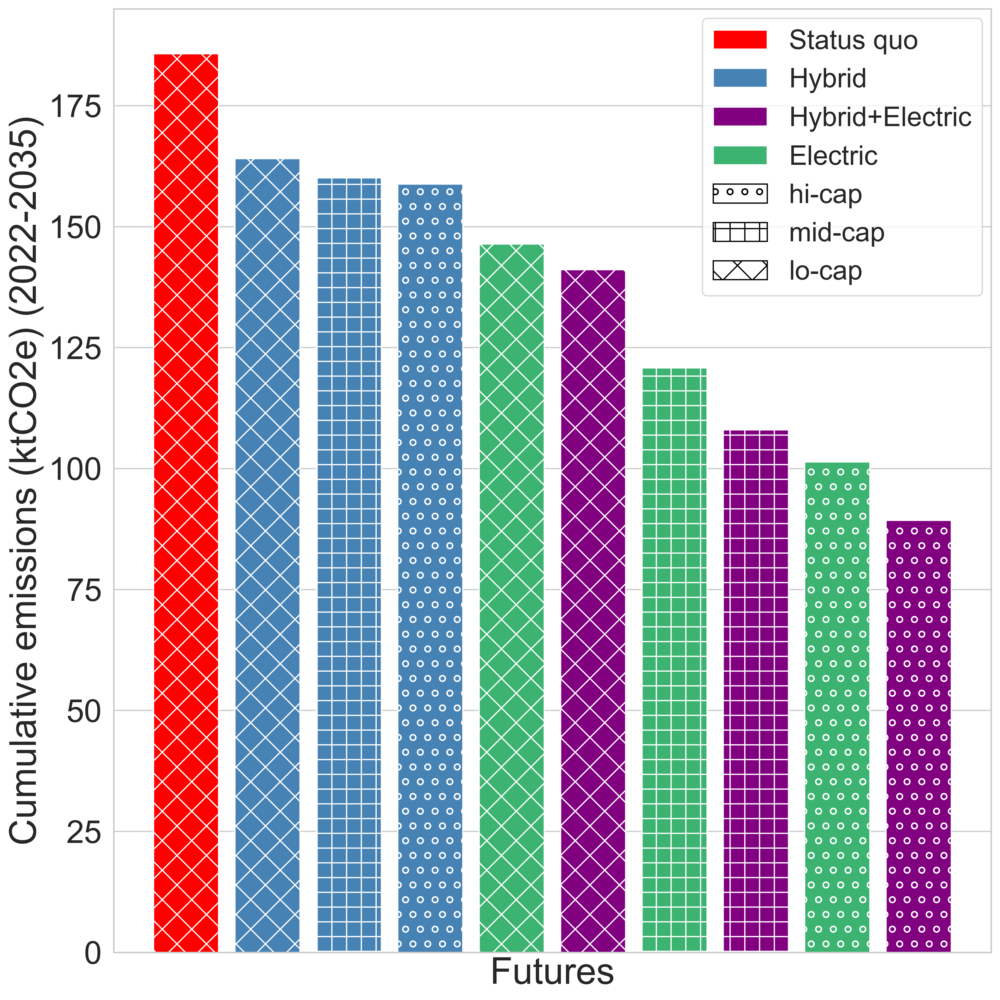

In [232]:
from matplotlib.patches import Patch

# Convert the pivot table into a long-form DataFrame for plotting
df_long = pivot_df_emission_numeric.reset_index().melt(id_vars=["Scenario"], var_name="Strategy", value_name="emissions")

# Remove rows where emissions is NaN (i.e., 'Status quo' for hi-cap and mid-cap)
df_long = df_long.dropna()

# Define colors and patterns based on the given format
colors = {"Status quo":"red", "Hybrid": "steelblue", "Hybrid+Electric": "purple", "Electric": "mediumseagreen"}
patterns_scenario = {"hi-cap": "o", "mid-cap": "+", "lo-cap": "x"}

# Sorting the DataFrame for visualization
df_sorted = df_long.sort_values(by="emissions", ascending=False).reset_index(drop=True)

# Custom barplot function
def custom_barplot(ax, data, patterns, colors):
    for i, row in enumerate(data.itertuples(), start=0):
        bar = ax.bar(i, row.emissions, color=colors[row.Strategy])
        bar[0].set_hatch(patterns[row.Scenario])

# Plotting
#plt.style.use('default')
sns.set_style("whitegrid")
plt.figure(figsize=(12, 12), dpi=400)
ax = plt.gca()
custom_barplot(ax, df_sorted, patterns_scenario, colors)

# Removing the x-axis labels and ticks
plt.xlabel("Futures", fontsize=30)
plt.xticks([])

plt.ylabel("Cumulative emissions (ktCO2e) (2022-2035)", fontsize=30)
plt.yticks(fontsize=26)

# Creating custom legend elements for colors and patterns
legend_elements_color = [Patch(facecolor=colors[key], label=key) for key in colors.keys()]
legend_elements_pattern = [Patch(facecolor='white', edgecolor='black', hatch=patterns_scenario[key], label=key) 
                           for key in patterns_scenario.keys()]

# Combining color and pattern legend elements
combined_legend_elements = legend_elements_color + legend_elements_pattern

# Creating a single legend
plt.legend(handles=combined_legend_elements, bbox_to_anchor=(0.99, 0.99), loc=1, borderaxespad=0, fontsize=22)

plt.tight_layout()
plt.show()


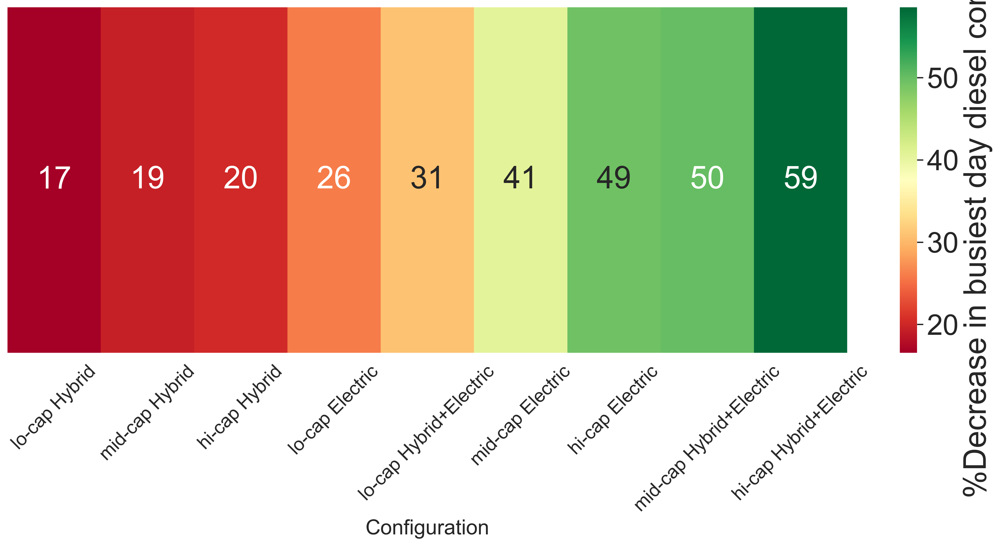

In [233]:
import seaborn as sns
import matplotlib.pyplot as plt

# Filter out the "Status quo" configuration
mean_results = mean_results[mean_results['Label'] != 'Status quo']

# Sort the data by % Decrease
mean_results = mean_results.sort_values(by='% Decrease')

# Convert DataFrame to a 2D array suitable for a heatmap
heatmap_data = mean_results.set_index('Label')['% Decrease'].T.values.reshape(1, -1)

plt.figure(figsize=(15, 8), dpi=400)

# Create the heatmap
sns.heatmap(heatmap_data, annot=True, cmap="RdYlGn", cbar_kws={'label': '%Decrease in busiest day diesel consumption'}, xticklabels=mean_results['Label'].tolist())

# Styling
plt.xticks(fontsize=18, rotation=45)
plt.yticks([])  # Hide the y-axis as it's not needed here
plt.xlabel('Configuration', fontsize=20)
#plt.title('% Decrease compared to Status quo across configurations', fontsize=22)

plt.tight_layout()
plt.savefig(r'../../figures/relative-decrease-heatmap.png', dpi=400)
plt.show()


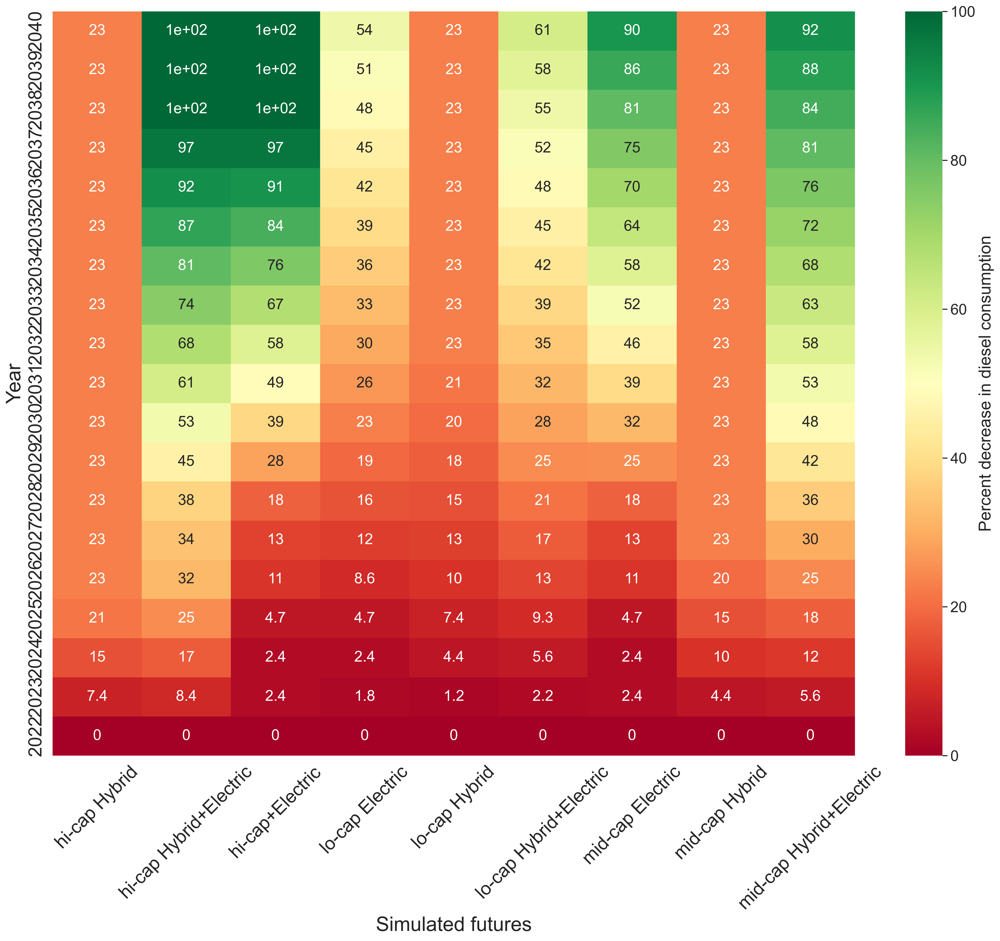

In [234]:
import seaborn as sns
import matplotlib.pyplot as plt

# Calculate % decrease relative to 'Status quo' for each Year
do_nothing_values = final_df[final_df['Label'] == 'Status quo'].set_index('Year')['Result'].to_dict()
final_df['% Decrease'] = final_df.apply(lambda row: 100 * (do_nothing_values[row['Year']] - row['Result']) / do_nothing_values[row['Year']], axis=1)
#print(final_df['Label'])

future_mapping = {
    'hi-cap Balanced Mix': 'hi-cap Hybrid+Electric',
    'hi-cap Electric': 'hi-cap+Electric',
    'hi-cap Hybrid': 'hi-cap Hybrid',
    'lo-cap Balanced Mix': 'lo-cap Hybrid+Electric',
    'lo-cap Electric': 'lo-cap Electric',
    'lo-cap Hybrid': 'lo-cap Hybrid',    
    'mid-cap Balanced Mix': 'mid-cap Hybrid+Electric',
    'mid-cap Electric': 'mid-cap Electric',
    'mid-cap Hybrid': 'mid-cap Hybrid',
}

# Replace values in the columns
final_df['Label'] = final_df['Label'].replace(future_mapping)

#print(final_df['Label'])


# Remove Status quo rows from the data as it will have a 0% decrease 
final_df = final_df[final_df['Label'] != 'Status quo']

# Pivot data for heatmap
sns.set(font_scale=1.5)
heatmap_data = final_df.pivot_table(index='Year', columns='Label', values='% Decrease')

plt.figure(figsize=(18, 16), dpi=400)

# Create the heatmap and store the returned axis in `ax`.
ax = sns.heatmap(heatmap_data, cmap="RdYlGn", annot=True, cbar_kws={'label': 'Percent decrease in diesel consumption'})

# Reverse the y-axis
ax.invert_yaxis()

# Rotate the x-axis labels
plt.xticks(rotation=45)

# Adjusting the colorbar
cbar = ax.collections[0].colorbar
cbar.ax.figure.subplots_adjust(right=0.8)
cbar.ax.set_ylabel('Percent decrease in diesel consumption', size=20)
cbar.ax.tick_params(labelsize=18)

# Styling
plt.xlabel('Simulated futures', fontsize=24)
plt.ylabel('Year', fontsize=24)

plt.xticks(fontsize=22)
plt.yticks(fontsize=22)

plt.tight_layout()
plt.savefig(r'../../figures/yearly-relative-decrease-heatmap.png', dpi=400)
plt.show()


In [235]:
# Pivot data for heatmap
sns.set(font_scale=1.5)

plt.figure(figsize=(22, 20), dpi=400)

# Create the heatmap and store the returned axis in `ax`.
ax = sns.heatmap(heatmap_data, cmap="RdYlGn", annot=False, cbar_kws={'label': 'Percent decrease in diesel consumption'})

# Reverse the y-axis
ax.invert_yaxis()

# Rotate the x-axis labels
plt.xticks(rotation=45)

# Adjusting the colorbar
cbar = ax.collections[0].colorbar
cbar.ax.figure.subplots_adjust(right=0.8)
cbar.ax.set_ylabel('Percent decrease in diesel consumption', size=40)
cbar.ax.tick_params(labelsize=30)

# Styling
plt.xlabel('Simulated futures', fontsize=40)
plt.ylabel('Year', fontsize=40)

plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
#plt.yticks(rotation=45)


plt.tight_layout()
plt.savefig(r'../../figures/yearly-relative-decrease-heatmap-v02.png', dpi=400)
plt.show()


In [236]:
### Prepare route-based diesel consumption for SQ and hi-cap BM

In [237]:
#H_BM_energy = pd.read_csv(r'../../results/highcap-BM-energy-by-routes.csv', low_memory=False)

In [238]:
#H_BM_energy = H_BM_energy.loc[H_BM_energy['Year']==12].copy()

In [239]:
#H_BM_energy = H_BM_energy.loc[H_BM_energy['Value']==1].copy()

In [240]:
#H_BM_energy = H_BM_energy.groupby('Route')[['Coefficient','dist']].sum().reset_index()

In [241]:
#H_BM_energy = H_BM_energy.rename(columns={'Coefficient': 'Diesel'})

In [242]:
#H_BM_energy['Diesel_per_mile']=H_BM_energy['Diesel']/H_BM_energy['dist']

In [243]:
#H_BM_energy.to_csv(r'../../results/highcap-balanced-mix-diesel.csv', index=False)

In [244]:
#SQ_filtered['Diesel'] = np.where(SQ_filtered['Powertrain'] != 'electric', SQ_filtered['Energy'], 0)

In [245]:
#SQ_filtered = SQ_filtered.groupby('Route')[['Diesel','dist']].sum().reset_index()

In [246]:
#SQ_filtered['Diesel_per_mile']=SQ_filtered['Diesel']/SQ_filtered['dist']

In [247]:
#SQ_filtered.to_csv(r'../../results/do-nothing-diesel.csv', index=False)

In [248]:
#PP_energy = pd.read_csv(r'../../results/highcap-PP-optimized-variables-with-replacement-aggregated.csv', low_memory=False)

In [249]:
#PP_energy = PP_energy.loc[PP_energy['Year']==12].copy()

In [250]:
#PP_energy = PP_energy.loc[PP_energy['Value']==1].copy()

In [251]:
#PP_energy = PP_energy.groupby('Route')[['Coefficient','dist']].sum().reset_index()

In [252]:
#PP_energy = PP_energy.rename(columns={'Coefficient': 'Diesel'})

In [253]:
#PP_energy['Diesel_per_mile']=PP_energy['Diesel']/PP_energy['dist']

In [254]:
#PP_energy.to_csv(r'../../results/pp-diesel.csv', index=False)

In [255]:
#H_FE_energy = pd.read_csv(r'../../results/highcap-FE-optimized-variables-aggregated.csv', low_memory=False)

In [256]:
#H_FE_energy = H_FE_energy.loc[H_FE_energy['Year']==12].copy()

In [257]:
#H_FE_energy = H_FE_energy.loc[H_FE_energy['Value']==1].copy()

In [258]:
#H_FE_energy = H_FE_energy.groupby('Route')[['Coefficient','dist']].sum().reset_index()

In [259]:
#H_FE_energy = H_FE_energy.rename(columns={'Coefficient': 'Diesel'})

In [260]:
#H_FE_energy['Diesel_per_mile']=H_FE_energy['Diesel']/H_FE_energy['dist']

In [261]:
#H_FE_energy.to_csv(r'../../results/FE-diesel.csv', index=False)

In [262]:
#H_BM_energy['Diesel'].sum()

In [263]:
#SQ_filtered['Diesel'].sum()

In [264]:
#PP_energy['Diesel'].sum()

In [265]:
### Prepare data for cost analysis

In [266]:
initial_values = {
    'HEB': 9,
    'BEB': 15
}

In [267]:
#h_pp = pd.read_csv(r'../../results/highcap-PP-optimized-variables-y.csv', low_memory=False)

# Drop CDBs
#h_pp = h_pp.loc[h_pp['Powertrain'] != 'CDB']

# Replace values for Year == 0 based on the initial values of each Powertrain
#h_pp.loc[(h_pp['Year'] == 0) & (h_pp['Powertrain'] == 'HEB'), 'Value'] = 9
#h_pp.loc[(h_pp['Year'] == 0) & (h_pp['Powertrain'] == 'BEB'), 'Value'] = 15

# Compute the difference in 'Value' column for each year compared to its previous year
#h_pp['Diff'] = h_pp.groupby('Powertrain')['Value'].diff()

# Fill NaN values with 0 and set negative values to 0
#h_pp['Diff'] = h_pp['Diff'].fillna(0).clip(lower=0)

# Calculate the investment cost for the additional fleet
#h_pp['Investment Cost (M$)'] = h_pp.apply(lambda row: 0.9 * row['Diff'] if row['Powertrain'] == 'HEB' else 1.3 * row['Diff'], axis=1)


In [269]:
h_FE = pd.read_csv(r'../../results/highcap-FE-optimized-variables-with-replacement-40percentBEBcharging-ContiniuedTo2040-y.csv', low_memory=False)
# Drop CDBs
h_FE = h_FE.loc[h_FE['Powertrain']!='CDB']

# Replace values for Year == 0 based on the initial values of each Powertrain
h_FE.loc[(h_FE['Year'] == 0) & (h_FE['Powertrain'] == 'HEB'), 'Value'] = 9
h_FE.loc[(h_FE['Year'] == 0) & (h_FE['Powertrain'] == 'BEB'), 'Value'] = 15

# Compute the difference in 'Value' column for each year compared to its previous year
h_FE['Diff'] = h_FE.groupby('Powertrain')['Value'].diff()

# Fill NaN values with 0 and set negative values to 0
h_FE['Diff'] = h_FE['Diff'].fillna(0).clip(lower=0)

# Calculate the investment cost for the additional fleet
h_FE['Investment Cost (M$)'] = h_FE.apply(lambda row: 0.9 * row['Diff'] if row['Powertrain'] == 'HEB' else 1.3 * row['Diff'], axis=1)

In [270]:
m_FE = pd.read_csv(r'../../results/midcap-FE-optimized-variables-with-replacement-40percentBEBcharging-ContiniuedTo2040-y.csv', low_memory=False)
# Drop CDBs
m_FE = m_FE.loc[m_FE['Powertrain']!='CDB']

# Replace values for Year == 0 based on the initial values of each Powertrain
m_FE.loc[(m_FE['Year'] == 0) & (m_FE['Powertrain'] == 'HEB'), 'Value'] = 9
m_FE.loc[(m_FE['Year'] == 0) & (m_FE['Powertrain'] == 'BEB'), 'Value'] = 15

# Compute the difference in 'Value' column for each year compared to its previous year
m_FE['Diff'] = m_FE.groupby('Powertrain')['Value'].diff()

# Fill NaN values with 0 and set negative values to 0
m_FE['Diff'] = m_FE['Diff'].fillna(0).clip(lower=0)

# Calculate the investment cost for the additional fleet
m_FE['Investment Cost (M$)'] = m_FE.apply(lambda row: 0.9 * row['Diff'] if row['Powertrain'] == 'HEB' else 1.3 * row['Diff'], axis=1)

In [271]:
l_FE = pd.read_csv(r'../../results/lowcap-FE-optimized-variables-with-replacement-40percentBEBcharging-ContiniuedTo2040-y.csv', low_memory=False)
# Drop CDBs
l_FE = l_FE.loc[l_FE['Powertrain']!='CDB']

# Replace values for Year == 0 based on the initial values of each Powertrain
l_FE.loc[(l_FE['Year'] == 0) & (l_FE['Powertrain'] == 'HEB'), 'Value'] = 9
l_FE.loc[(l_FE['Year'] == 0) & (l_FE['Powertrain'] == 'BEB'), 'Value'] = 15

# Compute the difference in 'Value' column for each year compared to its previous year
l_FE['Diff'] = l_FE.groupby('Powertrain')['Value'].diff()

# Fill NaN values with 0 and set negative values to 0
l_FE['Diff'] = l_FE['Diff'].fillna(0).clip(lower=0)

# Calculate the investment cost for the additional fleet
l_FE['Investment Cost (M$)'] = l_FE.apply(lambda row: 0.9 * row['Diff'] if row['Powertrain'] == 'HEB' else 1.3 * row['Diff'], axis=1)

In [272]:
h_FH = pd.read_csv(r'../../results/highcap-FH-optimized-variables-with-replacement-ContiniuedTo2040-y.csv', low_memory=False)
# Drop CDBs
h_FH = h_FH.loc[h_FH['Powertrain']!='CDB']

# Replace values for Year == 0 based on the initial values of each Powertrain
h_FH.loc[(h_FH['Year'] == 0) & (h_FH['Powertrain'] == 'HEB'), 'Value'] = 9
h_FH.loc[(h_FH['Year'] == 0) & (h_FH['Powertrain'] == 'BEB'), 'Value'] = 15

# Compute the difference in 'Value' column for each year compared to its previous year
h_FH['Diff'] = h_FH.groupby('Powertrain')['Value'].diff()

# Fill NaN values with 0 and set negative values to 0
h_FH['Diff'] = h_FH['Diff'].fillna(0).clip(lower=0)

# Calculate the investment cost for the additional fleet
h_FH['Investment Cost (M$)'] = h_FH.apply(lambda row: 0.9 * row['Diff'] if row['Powertrain'] == 'HEB' else 1.3 * row['Diff'], axis=1)

In [273]:
m_FH = pd.read_csv(r'../../results/midcap-FH-optimized-variables-with-replacement-ContiniuedTo2040-y.csv', low_memory=False)
# Drop CDBs
m_FH = m_FH.loc[m_FH['Powertrain']!='CDB']

# Replace values for Year == 0 based on the initial values of each Powertrain
m_FH.loc[(m_FH['Year'] == 0) & (m_FH['Powertrain'] == 'HEB'), 'Value'] = 9
m_FH.loc[(m_FH['Year'] == 0) & (m_FH['Powertrain'] == 'BEB'), 'Value'] = 15

# Compute the difference in 'Value' column for each year compared to its previous year
m_FH['Diff'] = m_FH.groupby('Powertrain')['Value'].diff()

# Fill NaN values with 0 and set negative values to 0
m_FH['Diff'] = m_FH['Diff'].fillna(0).clip(lower=0)

# Calculate the investment cost for the additional fleet
m_FH['Investment Cost (M$)'] = m_FH.apply(lambda row: 0.9 * row['Diff'] if row['Powertrain'] == 'HEB' else 1.3 * row['Diff'], axis=1)

In [274]:
l_FH = pd.read_csv(r'../../results/lowcap-FH-optimized-variables-with-replacement-ContiniuedTo2040-y.csv', low_memory=False)
# Drop CDBs
l_FH = l_FH.loc[l_FH['Powertrain']!='CDB']

# Replace values for Year == 0 based on the initial values of each Powertrain
l_FH.loc[(l_FH['Year'] == 0) & (l_FH['Powertrain'] == 'HEB'), 'Value'] = 9
l_FH.loc[(l_FH['Year'] == 0) & (l_FH['Powertrain'] == 'BEB'), 'Value'] = 15

# Compute the difference in 'Value' column for each year compared to its previous year
l_FH['Diff'] = l_FH.groupby('Powertrain')['Value'].diff()

# Fill NaN values with 0 and set negative values to 0
l_FH['Diff'] = l_FH['Diff'].fillna(0).clip(lower=0)

# Calculate the investment cost for the additional fleet
l_FH['Investment Cost (M$)'] = l_FH.apply(lambda row: 0.9 * row['Diff'] if row['Powertrain'] == 'HEB' else 1.3 * row['Diff'], axis=1)

In [276]:
h_BM = pd.read_csv(r'../../results/highcap-BM-optimized-variables-with-replacement-40percentBEBcharging-ContiniuedTo2040-y.csv', low_memory=False)
# Drop CDBs
h_BM = h_BM.loc[h_BM['Powertrain']!='CDB']

# Replace values for Year == 0 based on the initial values of each Powertrain
h_BM.loc[(h_BM['Year'] == 0) & (h_BM['Powertrain'] == 'HEB'), 'Value'] = 9
h_BM.loc[(h_BM['Year'] == 0) & (h_BM['Powertrain'] == 'BEB'), 'Value'] = 15

# Compute the difference in 'Value' column for each year compared to its previous year
h_BM['Diff'] = h_BM.groupby('Powertrain')['Value'].diff()

# Fill NaN values with 0 and set negative values to 0
h_BM['Diff'] = h_BM['Diff'].fillna(0).clip(lower=0)

# Calculate the investment cost for the additional fleet
h_BM['Investment Cost (M$)'] = h_BM.apply(lambda row: 0.9 * row['Diff'] if row['Powertrain'] == 'HEB' else 1.3 * row['Diff'], axis=1)

In [277]:
m_BM = pd.read_csv(r'../../results/midcap-BM-optimized-variables-with-replacement-40percentBEBcharging-ContiniuedTo2040-y.csv', low_memory=False)
# Drop CDBs
m_BM = m_BM.loc[m_BM['Powertrain']!='CDB']

# Replace values for Year == 0 based on the initial values of each Powertrain
m_BM.loc[(m_BM['Year'] == 0) & (m_BM['Powertrain'] == 'HEB'), 'Value'] = 9
m_BM.loc[(m_BM['Year'] == 0) & (m_BM['Powertrain'] == 'BEB'), 'Value'] = 15

# Compute the difference in 'Value' column for each year compared to its previous year
m_BM['Diff'] = m_BM.groupby('Powertrain')['Value'].diff()

# Fill NaN values with 0 and set negative values to 0
m_BM['Diff'] = m_BM['Diff'].fillna(0).clip(lower=0)

# Calculate the investment cost for the additional fleet
m_BM['Investment Cost (M$)'] = m_BM.apply(lambda row: 0.9 * row['Diff'] if row['Powertrain'] == 'HEB' else 1.3 * row['Diff'], axis=1)

In [278]:
l_BM = pd.read_csv(r'../../results/lowcap-BM-optimized-variables-with-replacement-40percentBEBcharging-ContiniuedTo2040-y.csv', low_memory=False)
# Drop CDBs
l_BM = l_BM.loc[l_BM['Powertrain']!='CDB']

# Replace values for Year == 0 based on the initial values of each Powertrain
l_BM.loc[(l_BM['Year'] == 0) & (l_BM['Powertrain'] == 'HEB'), 'Value'] = 9
l_BM.loc[(l_BM['Year'] == 0) & (l_BM['Powertrain'] == 'BEB'), 'Value'] = 15

# Compute the difference in 'Value' column for each year compared to its previous year
l_BM['Diff'] = l_BM.groupby('Powertrain')['Value'].diff()

# Fill NaN values with 0 and set negative values to 0
l_BM['Diff'] = l_BM['Diff'].fillna(0).clip(lower=0)

# Calculate the investment cost for the additional fleet
l_BM['Investment Cost (M$)'] = l_BM.apply(lambda row: 0.9 * row['Diff'] if row['Powertrain'] == 'HEB' else 1.3 * row['Diff'], axis=1)

In [279]:
h_FE['Investment Cost (M$)'].sum()

343.2

In [280]:
h_FE

,Powertrain,Value,Year,Diff,Investment Cost (M$)
19,HEB,9,0,0.0,0.0
20,HEB,9,1,0.0,0.0
21,HEB,9,2,0.0,0.0
22,HEB,9,3,0.0,0.0
23,HEB,9,4,0.0,0.0
24,HEB,9,5,0.0,0.0
25,HEB,9,6,0.0,0.0
26,HEB,9,7,0.0,0.0
27,HEB,9,8,0.0,0.0
28,HEB,9,9,0.0,0.0


In [281]:
# Group by 'Year' and sum 'Investment Cost (M$)'
#h_pp = h_pp.groupby('Year')['Investment Cost (M$)'].sum().reset_index()
#h_pp['future'] = 'PVTA plan'
h_FE = h_FE.groupby('Year')['Investment Cost (M$)'].sum().reset_index()
h_FE['future'] = 'hi-cap Electric'
m_FE = m_FE.groupby('Year')['Investment Cost (M$)'].sum().reset_index()
m_FE['future'] = 'mid-cap Electric'
l_FE = l_FE.groupby('Year')['Investment Cost (M$)'].sum().reset_index()
l_FE['future'] = 'lo-cap Electric'
h_FH = h_FH.groupby('Year')['Investment Cost (M$)'].sum().reset_index()
h_FH['future'] = 'hi-cap Hybrid'
m_FH = m_FH.groupby('Year')['Investment Cost (M$)'].sum().reset_index()
m_FH['future'] = 'mid-cap Hybrid'
l_FH = l_FH.groupby('Year')['Investment Cost (M$)'].sum().reset_index()
l_FH['future'] = 'lo-cap Hybrid'
h_BM = h_BM.groupby('Year')['Investment Cost (M$)'].sum().reset_index()
h_BM['future'] = 'hi-cap Hybrid+Electric'
m_BM = m_BM.groupby('Year')['Investment Cost (M$)'].sum().reset_index()
m_BM['future'] = 'mid-cap Hybrid+Electric'
l_BM = l_BM.groupby('Year')['Investment Cost (M$)'].sum().reset_index()
l_BM['future'] = 'lo-cap Hybrid+Electric'

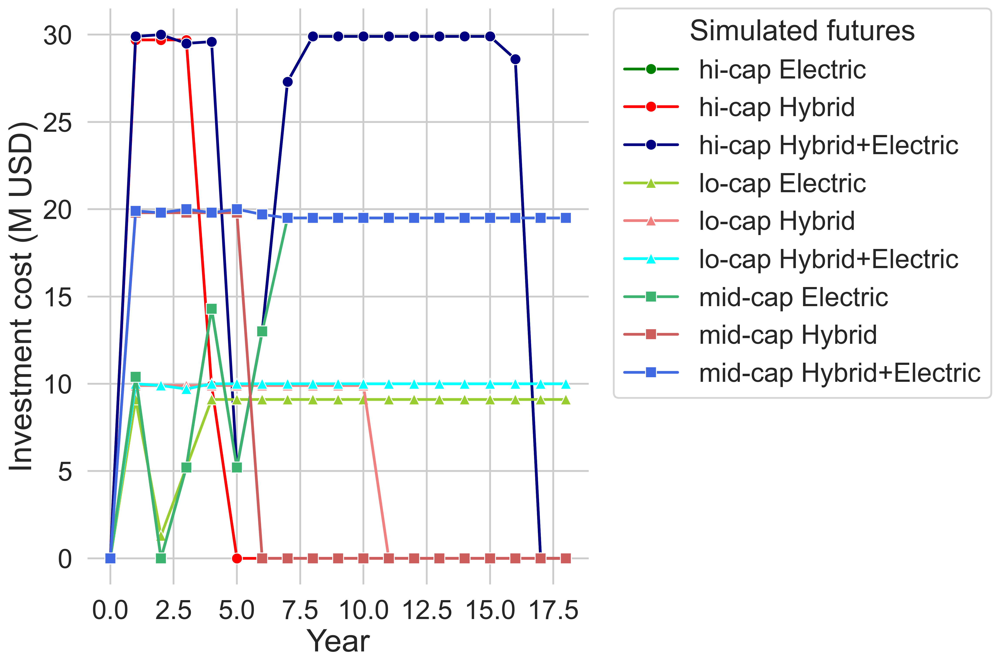

In [282]:
# Define a custom palette and marker order
custom_palette = {
    "Status quo": "black",
    "lo-cap Hybrid": "lightcoral",
    "mid-cap Hybrid": "indianred",
    "hi-cap Hybrid": "red",
    "lo-cap Hybrid+Electric": "aqua",
    "mid-cap Hybrid+Electric": "royalblue",
    "hi-cap Hybrid+Electric": "navy",
    "lo-cap Electric": "yellowgreen",
    "mid-cap Electric": "mediumseagreen",
    "hi-cap Electric": "green"
}
custom_markers = {
    "Status quo": "P",
    "lo-cap Hybrid": "^",
    "mid-cap Hybrid": "s",
    "hi-cap Hybrid": "o",
    "lo-cap Hybrid+Electric": "^",
    "mid-cap Hybrid+Electric": "s",
    "hi-cap Hybrid+Electric": "o",
    "lo-cap Electric": "^",
    "mid-cap Electric": "s",
    "hi-cap Electric": "o"
}


# Merge dataframes
dataframes = [h_FE, m_FE, l_FE, h_FH, m_FH, l_FH, h_BM, m_BM, l_BM]  # Add all your dataframes in this list
merged_df = pd.concat(dataframes, ignore_index=True)

# Group by Year and future, then summing up the Investment Cost for each group
grouped_df = merged_df.groupby(['Year', 'future'])['Investment Cost (M$)'].sum().reset_index()

# Get the markers in the same order as the unique values in the 'future' column
markers_order = [custom_markers[future] for future in grouped_df['future'].unique()]


# Plotting with Seaborn
plt.figure(figsize=(12,8), dpi=400)
sns.set_style("whitegrid")
sns.set_context("talk")  # makes everything larger
sns.lineplot(data=grouped_df, x='Year', y='Investment Cost (M$)', hue='future',
                    palette=custom_palette, markers=markers_order, dashes=False, style='future')

plt.xlabel('Year', fontsize=26)
plt.ylabel('Investment cost (M USD)', fontsize=26)

# Move the legend to the right outside of the plot
plt.legend(title='Simulated futures', bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=22, title_fontsize='24')

plt.xticks(fontsize=22)
plt.yticks(fontsize=22)

plt.grid(True)
sns.despine(left=True, bottom=True)
plt.tight_layout()

# Save the figure before showing it
plt.savefig(r'../../figures/investment_cost_plot.png', bbox_inches='tight', dpi=400)  
plt.show()


In [283]:
# Define a mapping dictionary
year_mapping = {i: 2022 + i for i in range(0, 19)}

# Apply the mapping
grouped_df['Year'] = grouped_df['Year'].map(year_mapping)

print(final_df)

     Year       Result Scenario Strategy      dist_BEB      dist_CDB  \
19   2022  2738.750000        h       FH    674.998976  10965.000000   
20   2023  2535.812907        h       FH    674.996965   7666.020443   
21   2024  2319.375537        h       FH    674.999653   4365.924070   
22   2025  2151.339705        h       FH    674.996965   1066.046823   
23   2026  2116.845970        h       FH    674.972509      0.000000   
..    ...          ...      ...      ...           ...           ...   
185  2036   645.890019        m       BM   7739.991687      0.000000   
186  2037   533.541676        m       BM   8414.971644      0.000000   
187  2038   425.615739        m       BM   9089.875157      0.000000   
188  2039   323.111088        m       BM   9764.998531      0.000000   
189  2040   227.294178        m       BM  10439.936587      0.000000   

         dist_HEB                    Label   YearlyResult  Yearly_dist_CDB  \
19     899.999000            hi-cap Hybrid  707460.738888

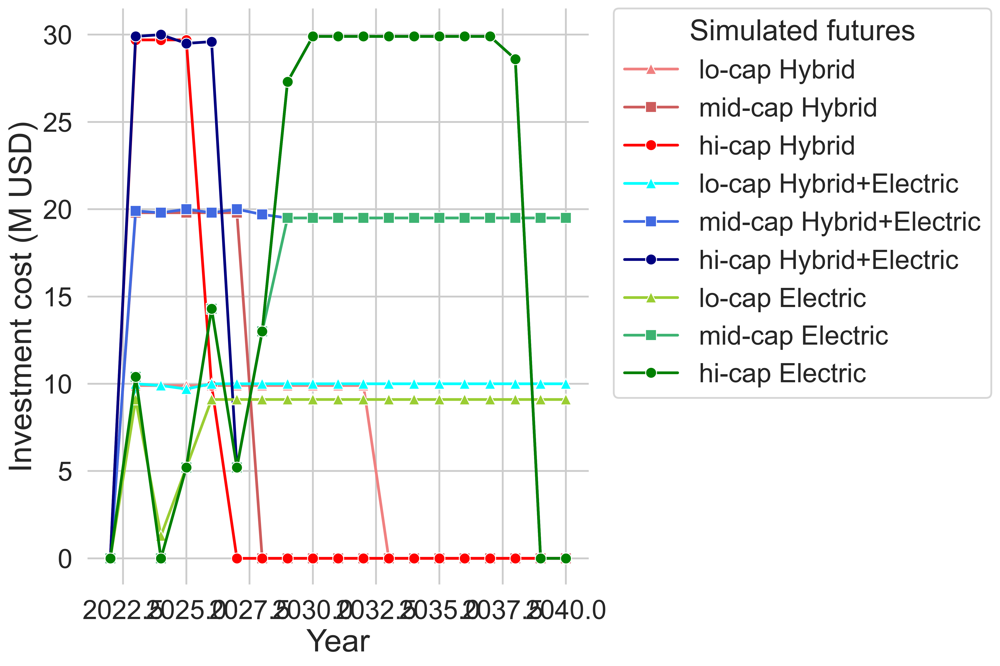

In [284]:
# Plotting with Seaborn
custom_palette = {
    "lo-cap Hybrid": "lightcoral",
    "mid-cap Hybrid": "indianred",
    "hi-cap Hybrid": "red",
    "lo-cap Hybrid+Electric": "aqua",
    "mid-cap Hybrid+Electric": "royalblue",
    "hi-cap Hybrid+Electric": "navy",
    "lo-cap Electric": "yellowgreen",
    "mid-cap Electric": "mediumseagreen",
    "hi-cap Electric": "green"
}

plt.figure(figsize=(12,8), dpi=400)
sns.set_style("whitegrid")
sns.set_context("talk")  # makes everything larger

# Set the hue_order based on custom_palette
sns.lineplot(data=grouped_df, x='Year', y='Investment Cost (M$)', hue='future',
             palette=custom_palette, markers=markers_order, dashes=False, style='future',
             hue_order=custom_palette.keys())  # This line forces the order

plt.xlabel('Year', fontsize=26)
plt.ylabel('Investment cost (M USD)', fontsize=26)

# Move the legend to the right outside of the plot
plt.legend(title='Simulated futures', bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=22, title_fontsize='24')

plt.xticks(fontsize=22)
plt.yticks(fontsize=22)

plt.grid(True)
sns.despine(left=True, bottom=True)
plt.tight_layout()

# Save the figure before showing it
plt.savefig(r'../../figures/investment_cost_plot.png', bbox_inches='tight', dpi=400)  
plt.show()


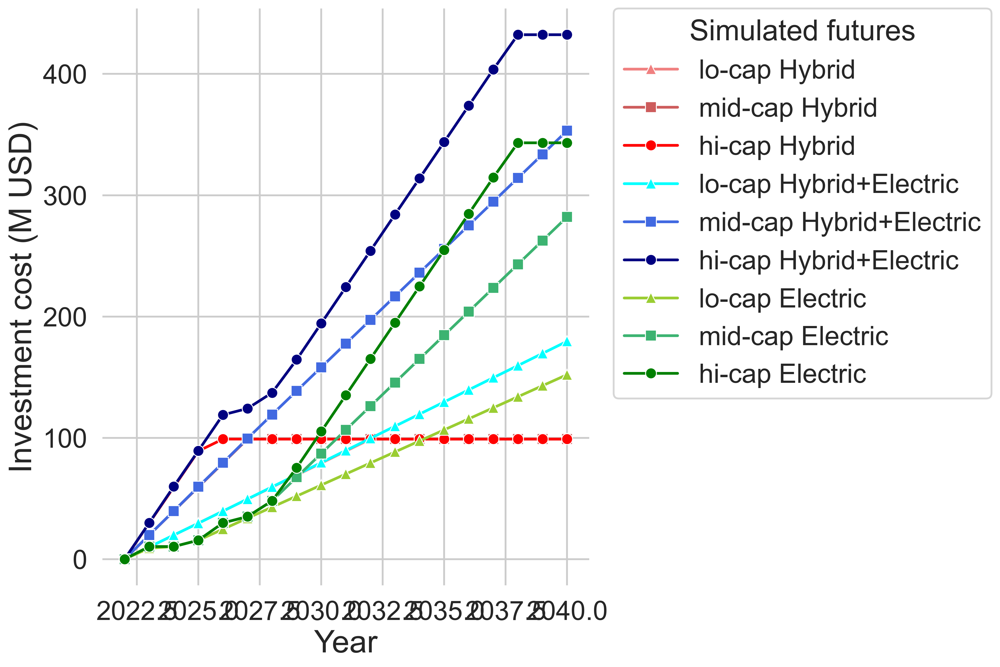

In [285]:
# Sorting by 'Year' and calculating the cumulative sum for each 'future' group
grouped_df['Cumulative Cost'] = grouped_df.sort_values(by='Year').groupby('future')['Investment Cost (M$)'].cumsum()

plt.figure(figsize=(12,8), dpi=400)
sns.set_style("whitegrid")
sns.set_context("talk")  # makes everything larger

# Adjust the sns.lineplot function to use 'Cumulative Cost' column
sns.lineplot(data=grouped_df, x='Year', y='Cumulative Cost', hue='future',
             palette=custom_palette, markers=markers_order, dashes=False, style='future',
             hue_order=custom_palette.keys())

plt.xlabel('Year', fontsize=26)
plt.ylabel('Investment cost (M USD)', fontsize=26)

# Move the legend to the right outside of the plot
plt.legend(title='Simulated futures', bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=22, title_fontsize='24')

plt.xticks(fontsize=22)
plt.yticks(fontsize=22)

plt.grid(True)
sns.despine(left=True, bottom=True)
plt.tight_layout()

# Save the figure before showing it
plt.savefig(r'../../figures/investment_cost_plot.png', bbox_inches='tight', dpi=400)  
plt.show()

In [286]:
grouped_df

,Year,future,Investment Cost (M$),Cumulative Cost
0,2022,hi-cap Electric,0.0,0.0
1,2022,hi-cap Hybrid,0.0,0.0
2,2022,hi-cap Hybrid+Electric,0.0,0.0
3,2022,lo-cap Electric,0.0,0.0
4,2022,lo-cap Hybrid,0.0,0.0
...,...,...,...,...
166,2040,lo-cap Hybrid,0.0,99.0
167,2040,lo-cap Hybrid+Electric,10.0,179.6
168,2040,mid-cap Electric,19.5,282.1
169,2040,mid-cap Hybrid,0.0,99.0


In [287]:
pivot_df

Strategy,Hybrid,Hybrid+Electric,Electric
Scenario,,,
lo-cap,16.553305,30.882461,25.941881
mid-cap,19.343517,50.139507,40.525848
hi-cap,20.251810,58.545114,49.433716


In [288]:
pivot_df.to_pickle(r'../../results/pivot_df-ContiniuedTo2040.pkl')

In [289]:
final_df

,Year,Result,Scenario,Strategy,dist_BEB,dist_CDB,dist_HEB,Label,YearlyResult,Yearly_dist_CDB,Yearly_dist_HEB,Yearly_dist_BEB,CO2e_CDB,CO2e_HEB,CO2e,YearlyResult100000gals,% Decrease
19,2022,2738.750000,h,FH,674.998976,10965.000000,899.999000,hi-cap Hybrid,707460.738888,2.832426e+06,2.324834e+05,1.743625e+05,9155.839172,619.833953,9775.673124,7.074607,0.000000
20,2023,2535.812907,h,FH,674.996965,7666.020443,4199.871578,hi-cap Hybrid,655039.004235,1.980250e+06,1.084891e+06,1.743620e+05,6401.171934,2892.473215,9293.645149,6.550390,7.409844
21,2024,2319.375537,h,FH,674.999653,4365.924070,7499.965263,hi-cap Hybrid,599129.942973,1.127785e+06,1.937355e+06,1.743627e+05,3645.572150,5165.264755,8810.836904,5.991299,15.312623
22,2025,2151.339705,h,FH,674.996965,1066.046823,10799.845198,hi-cap Hybrid,555723.734366,2.753761e+05,2.789764e+06,1.743620e+05,890.155336,7437.909084,8328.064420,5.557237,21.448117
23,2026,2116.845970,h,FH,674.972509,0.000000,11865.916477,hi-cap Hybrid,546813.478398,0.000000e+00,3.065147e+06,1.743557e+05,0.000000,8172.117871,8172.117871,5.468135,22.707587
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
185,2036,645.890019,m,BM,7739.991687,0.000000,4800.897299,mid-cap Hybrid+Electric,166843.205944,0.000000e+00,1.240145e+06,1.999357e+06,0.000000,3306.402729,3306.402729,1.668432,76.416613
186,2037,533.541676,m,BM,8414.971644,0.000000,4125.917342,mid-cap Hybrid+Electric,137821.921839,0.000000e+00,1.065787e+06,2.173715e+06,0.000000,2841.540551,2841.540551,1.378219,80.518789
187,2038,425.615739,m,BM,9089.875157,0.000000,3451.013828,mid-cap Hybrid+Electric,109943.012423,0.000000e+00,8.914493e+05,2.348053e+06,0.000000,2376.731021,2376.731021,1.099430,84.459489
188,2039,323.111088,m,BM,9764.998531,0.000000,2775.890455,mid-cap Hybrid+Electric,83464.503435,0.000000e+00,7.170547e+05,2.522447e+06,0.000000,1911.770072,1911.770072,0.834645,88.202242


In [290]:
final_df.to_csv(r'../../results/df_emissions_per_future-ContiniuedTo2040.csv', index=False)